# Analysis of Spatial Datasets
- Ruoyi Jiang
- July 5, 2024

1. Integrate datasets X
2. Define microanatomy X
3. Signature identification (w pseudobulk) X
4. Integrate single cell and signature identification (where is the single cell) X

In [1]:
library(Seurat)
library(ggplot2)
library(ggrepel)
library(RColorBrewer)

library(tidyverse)

library(enrichR)

Loading required package: SeuratObject

Loading required package: sp


Attaching package: ‘SeuratObject’


The following objects are masked from ‘package:base’:

    intersect, t


── Attaching core tidyverse packages ─────────────────────────────────────────────────────── tidyverse 2.0.0 ──
✔ dplyr     1.1.4     ✔ readr     2.1.5
✔ forcats   1.0.0     ✔ stringr   1.5.1
✔ lubridate 1.9.3     ✔ tibble    3.2.1
✔ purrr     1.0.2     ✔ tidyr     1.3.1
── Conflicts ───────────────────────────────────────────────────────────────────────── tidyverse_conflicts() ──
✖ dplyr::filter() masks stats::filter()
✖ dplyr::lag()    masks stats::lag()
ℹ Use the conflicted package (<http://conflicted.r-lib.org/>) to force all conflicts to become errors
Welcome to enrichR
Checking connection ... 

Enrichr ... 
Connection is Live!

FlyEnrichr ... 
Connection is Live!

WormEnrichr ... 
Connection is Live!

YeastEnrichr ... 
Connection is Live!

FishEnrichr ... 
Connection is Live!

OxEnrichr ... 
Connection

In [2]:
sessionInfo()

R version 4.3.3 (2024-02-29)
Platform: x86_64-redhat-linux-gnu (64-bit)
Running under: Fedora Linux 38 (Workstation Edition)

Matrix products: default
BLAS/LAPACK: FlexiBLAS OPENBLAS-OPENMP;  LAPACK version 3.11.0

locale:
 [1] LC_CTYPE=en_US.UTF-8       LC_NUMERIC=C              
 [3] LC_TIME=en_US.UTF-8        LC_COLLATE=en_US.UTF-8    
 [5] LC_MONETARY=en_US.UTF-8    LC_MESSAGES=en_US.UTF-8   
 [7] LC_PAPER=en_US.UTF-8       LC_NAME=C                 
 [9] LC_ADDRESS=C               LC_TELEPHONE=C            
[11] LC_MEASUREMENT=en_US.UTF-8 LC_IDENTIFICATION=C       

time zone: America/New_York
tzcode source: system (glibc)

attached base packages:
[1] stats     graphics  grDevices utils     datasets  methods   base     

other attached packages:
 [1] enrichR_3.2        lubridate_1.9.3    forcats_1.0.0      stringr_1.5.1     
 [5] dplyr_1.1.4        purrr_1.0.2        readr_2.1.5        tidyr_1.3.1       
 [9] tibble_3.2.1       tidyverse_2.0.0    RColorBrewer_1.1-3 ggrepel_0.9.5  

In [3]:
#Plotting
plotFigure <- function(plot, file, width, height){
    pdf(file, width=width, height=height)
    plot(plot)
    dev.off()
}

In [4]:
# This implementation of FindMarkers for pseudobulk is needed to expand formula to include covariate, PATIENT, when running DESeq2
# if patient_field is NULL, runs the same as Seurat FindMarkers DESeq2

DESeq2FullVersion <- function(obj, status_1, status_2, cluster_id, patient_field=NULL){
    # note, object should already be subset and status_1 and status_2 should be only status in object
    
    group.info <- data.frame(row.names = colnames(obj), wellKey = colnames(obj)) %>% 
    rowwise() %>%
    mutate(STATUS = strsplit(wellKey, split = "_")[[1]][1], 
            PATIENT = strsplit(wellKey, split = "_")[[1]][2],
            CLUSTER =  strsplit(wellKey, split = "_")[[1]][3]) %>%
    mutate(group = if(STATUS == status_1 & CLUSTER == cluster_id){"Group2"}
           else if(STATUS == status_2 & CLUSTER == cluster_id){"Group1"}
               else{"None"} %>% as.factor()) %>%
    filter(group != "None")

    group.info$wellKey <- rownames(x = group.info)        

    if(!(patient_field  %>% is.null())){
        patient_field <- paste("+", patient_field)
    }
           
    dds1 <- DESeq2::DESeqDataSetFromMatrix(
      countData = obj$SCT$counts,
      colData = group.info,
      design = formula(paste("~ group", patient_field))
    )
    
    dds1 <- DESeq2::estimateSizeFactors(object = dds1)
    dds1 <- DESeq2::estimateDispersions(object = dds1, fitType = "local")
    dds1 <- DESeq2::nbinomWaldTest(object = dds1)
    
    DESeq2::results(dds1,
                   name = "group_Group2_vs_Group1",
                   alpha = 0.05) %>% return()
    # DESeq2::lfcShrink(dds1,
    #                  coef = "group_Group2_vs_Group1",
    #                  res=res_pre,
    #                  type = "apeglm")

}

In [5]:
plotGene <- function(object, gene_name, plot_cell = NULL, type = "pca"){
    
    if(is.null(plot_cell)){
        plot_cell <- rep(TRUE, length(object@active.ident))
    }
    
    expr_vec <- object@assays$SCT@data[gene_name, plot_cell]
    identity_df <- data.frame(IDENTITY = object@active.ident[plot_cell])
    
    if(type == "pca"){
        projection_df <- data.frame(object@reductions$pca@cell.embeddings)
        p <- ggplot(projection_df[plot_cell,], aes(x = PC1, y = PC2))
    }
    if(type == "umap"){
        projection_df <- data.frame(object@reductions$umap@cell.embeddings)[plot_cell,]
        p <- ggplot(projection_df, aes(x = umap_1, y = umap_2))
    }
        
    p <- p + 
        theme_bw() +
        theme( axis.title.x=element_text(size=12), axis.title.y=element_text(size=12),
                 axis.text.x=element_blank(),
                axis.ticks.x=element_blank(),
              axis.text.y=element_blank(),
                axis.ticks.y=element_blank(),
              panel.grid.major = element_blank(),
              panel.grid.minor = element_blank()
             ) +
        scale_colour_gradient2(low = "#EBEBEB", mid = "#D9D9D9",
          high = "#132B43", name=gene_name) +
        geom_point(size = 0.2, aes(color=as.numeric(expr_vec)), alpha = 0.8) +
        xlab("Component 1") +
        ylab("Component 2")
    
    return(p)
}

### Define parameters

In [6]:
plot_dir <- "/home/ruoyi/Dropbox/Projects/Gelhausen_CLE/figures"

In [7]:
output_dir <- "/home/ruoyi/Dropbox/Projects/Gelhausen_CLE/Spatial/data"

In [8]:
meta_df <- read.csv("/home/ruoyi/Dropbox/Projects/Gelhausen_CLE/meta.csv") %>%
    filter(METHOD == "SPATIAL") 

In [9]:
meta_list <- meta_df %>%
    split(.$SAMPLE) %>%
    map(~select(., -SAMPLE))

meta_df <- meta_df %>% 
    left_join(data.frame(SAMPLE = names(meta_list)) %>% mutate(LOAD_ROW = as.character(row_number())))

Joining with `by = join_by(SAMPLE)`


In [10]:
meta_df

SAMPLE,PATIENT,STATUS,DISEASE,TREATMENT,PATH,METHOD,LOAD_ROW
<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>
DLE_A,DLE1,LUPUS,DLE,BEFORE,/home/ruoyi/andromeda/projects/gelhausen_cle/gelhausen_8_sample_dataset/DLE_A,SPATIAL,3
DLE_B,DLE2,LUPUS,DLE,BEFORE,/home/ruoyi/andromeda/projects/gelhausen_cle/gelhausen_8_sample_dataset/DLE_B,SPATIAL,4
HC5,HC1,HEALTHY,HEALTHY,BEFORE,/home/ruoyi/andromeda/projects/gelhausen_cle/gelhausen_8_sample_dataset/HC5,SPATIAL,5
HCSA,HC2,HEALTHY,HEALTHY,BEFORE,/home/ruoyi/andromeda/projects/gelhausen_cle/gelhausen_8_sample_dataset/HCSA,SPATIAL,6
X2_post_IFN_2,X2,LUPUS,LE AFTER,AFTER,/home/ruoyi/andromeda/projects/gelhausen_cle/gelhausen_8_sample_dataset/X2_post_IFN_2,SPATIAL,9
X2_pre_IFN_1,X2,LUPUS,LE BEFORE,BEFORE,/home/ruoyi/andromeda/projects/gelhausen_cle/gelhausen_8_sample_dataset/X2_pre_IFN_1,SPATIAL,10
X3_post_IFN_2,X3,LUPUS,LE AFTER,AFTER,/home/ruoyi/andromeda/projects/gelhausen_cle/gelhausen_8_sample_dataset/X3_post_IFN_2,SPATIAL,11
X3_pre_IFN_1,X3,LUPUS,LE BEFORE,BEFORE,/home/ruoyi/andromeda/projects/gelhausen_cle/gelhausen_8_sample_dataset/X3_pre_IFN_1,SPATIAL,12
DLE,DLE3,LUPUS,DLE,BEFORE,/home/ruoyi/andromeda/projects/gelhausen_cle/gelhausen_4_sample_dataset/DLE/outs,SPATIAL,2


In [11]:
DISEASE_NAMES <- list(
'HEALTHY' = 'Uninvolved',
'DLE' = 'DLE',
'LE BEFORE' = 'Pre-Therapy',
'LE AFTER' = 'Post-Therapy',
'LE.BEFORE' = 'Pre-Therapy',
'LE.AFTER' = 'Post-Therapy'
)

DISEASE_COLORS <- c(
'Uninvolved' = '#79C5F0',
'DLE' = '#CC6666',
'Pre-Therapy' = '#F6A7AD',
'Post-Therapy' = '#66CCCC'
)

DISEASE_ORDER <- c('Uninvolved', 'DLE', 'Pre-Therapy', 'Post-Therapy')

# Load data into Seurat and Normalize

In [12]:
obj_list <- list()
for(sample in names(meta_list)){
    obj_list[[sample]] <- Load10X_Spatial(unlist(meta_list[[sample]])['PATH'])
    obj_list[[sample]]@meta.data$SAMPLE <- sample
    obj_list[[sample]]@meta.data <- bind_cols(obj_list[[sample]]@meta.data, meta_list[[sample]] %>% select(-PATH, -METHOD))
}

In [13]:
variable.features <- c()

for(sample in names(obj_list)){
    obj_list[[sample]] <- SCTransform(obj_list[[sample]], assay = "Spatial", verbose = FALSE)
    variable.features <- c(variable.features, VariableFeatures(obj_list[[sample]]))
    cat(sample, format(Sys.time(), "%a %b %d %X %Y"), "\n")
}

Ctrl_C1RF Tue Aug 27 09:05:27 PM 2024 
DLE Tue Aug 27 09:05:44 PM 2024 
DLE_A Tue Aug 27 09:05:55 PM 2024 
DLE_B Tue Aug 27 09:06:07 PM 2024 
HC5 Tue Aug 27 09:06:12 PM 2024 
HCSA Tue Aug 27 09:06:20 PM 2024 
SCLE_post Tue Aug 27 09:06:26 PM 2024 
SCLE_pre Tue Aug 27 09:06:34 PM 2024 
X2_post_IFN_2 Tue Aug 27 09:06:41 PM 2024 
X2_pre_IFN_1 Tue Aug 27 09:06:47 PM 2024 
X3_post_IFN_2 Tue Aug 27 09:06:58 PM 2024 
X3_pre_IFN_1 Tue Aug 27 09:07:06 PM 2024 


# Intermediate Plotting

In [57]:
plot1 <- VlnPlot(obj_list[[sample]], features = "nCount_Spatial", pt.size = 0.1) + NoLegend()
plot2 <- SpatialFeaturePlot(obj_list[[sample]], features = "nCount_Spatial") + theme(legend.position = "right")
wrap_plots(plot1, plot2)

Warning message:
“Default search for "data" layer in "Spatial" assay yielded no results; utilizing "counts" layer instead.”


ERROR: Error in wrap_plots(plot1, plot2): could not find function "wrap_plots"


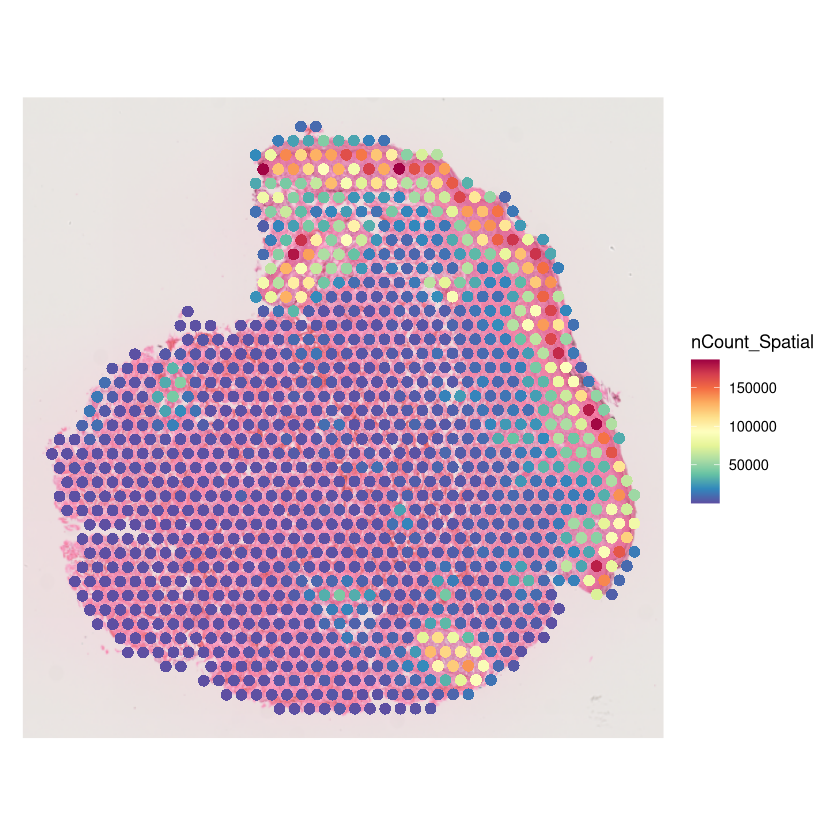

In [58]:
plot(plot2)

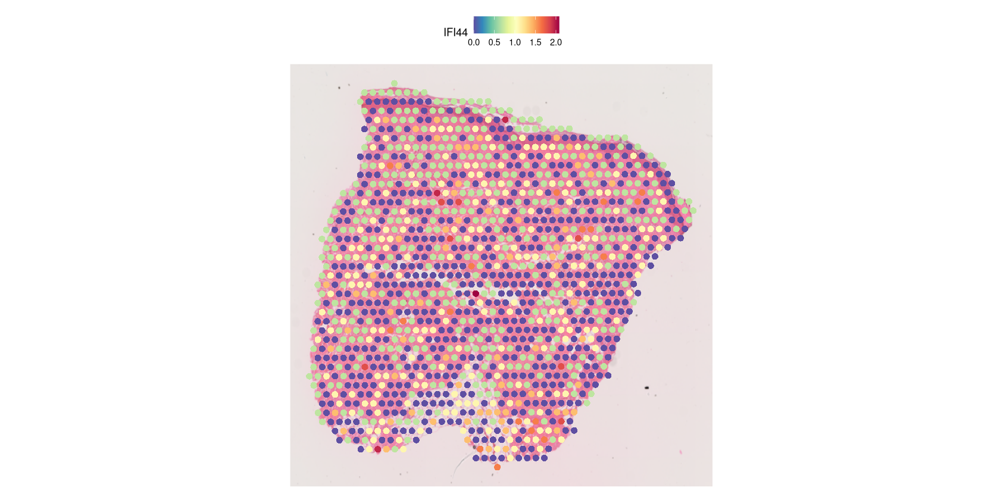

In [57]:
SpatialFeaturePlot(obj, features = c("IFI44"))

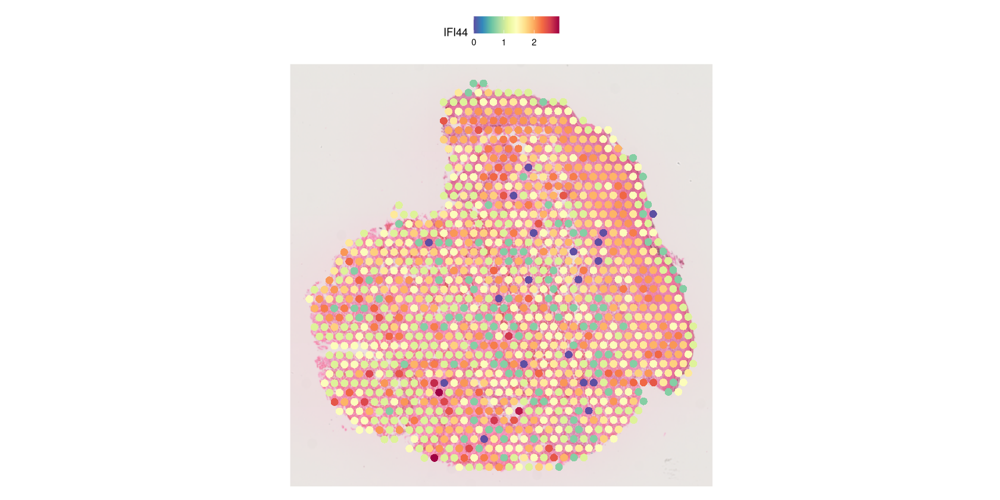

In [45]:
SpatialFeaturePlot(obj, features = c("IFI44"))

# Direct Merge

In [111]:
obj.merge <- merge(obj_list[[1]],obj_list[-1], add.cell.ids = names(obj_list))

Warning message:
“Key ‘slice1_’ taken, using ‘slice12_’ instead”
Warning message:
“Key ‘slice1_’ taken, using ‘slice13_’ instead”
Warning message:
“Key ‘slice1_’ taken, using ‘slice14_’ instead”
Warning message:
“Key ‘slice1_’ taken, using ‘slice15_’ instead”
Warning message:
“Key ‘slice1_’ taken, using ‘slice16_’ instead”
Warning message:
“Key ‘slice1_’ taken, using ‘slice17_’ instead”
Warning message:
“Key ‘slice1_’ taken, using ‘slice18_’ instead”


In [112]:
names(obj.merge@images) <- names(obj_list)
DefaultAssay(obj.merge) <- "SCT"

In [114]:
VariableFeatures(obj.merge) <- variable.features

In [115]:
obj.merge <- RunPCA(obj.merge, verbose = FALSE)
obj.merge <- FindNeighbors(obj.merge, dims = 1:30)
obj.merge <- FindClusters(obj.merge, verbose = FALSE)
obj.merge <- RunUMAP(obj.merge, dims = 1:30)

Computing nearest neighbor graph

Computing SNN

22:44:23 UMAP embedding parameters a = 0.9922 b = 1.112

22:44:23 Read 8984 rows and found 30 numeric columns

22:44:23 Using Annoy for neighbor search, n_neighbors = 30

22:44:23 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

22:44:24 Writing NN index file to temp file /tmp/Rtmp5W8HGh/file569924c049c62

22:44:24 Searching Annoy index using 1 thread, search_k = 3000

22:44:27 Annoy recall = 100%

22:44:27 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

22:44:29 Initializing from normalized Laplacian + noise (using RSpectra)

22:44:29 Commencing optimization for 500 epochs, with 399074 positive edges

22:44:41 Optimization finished



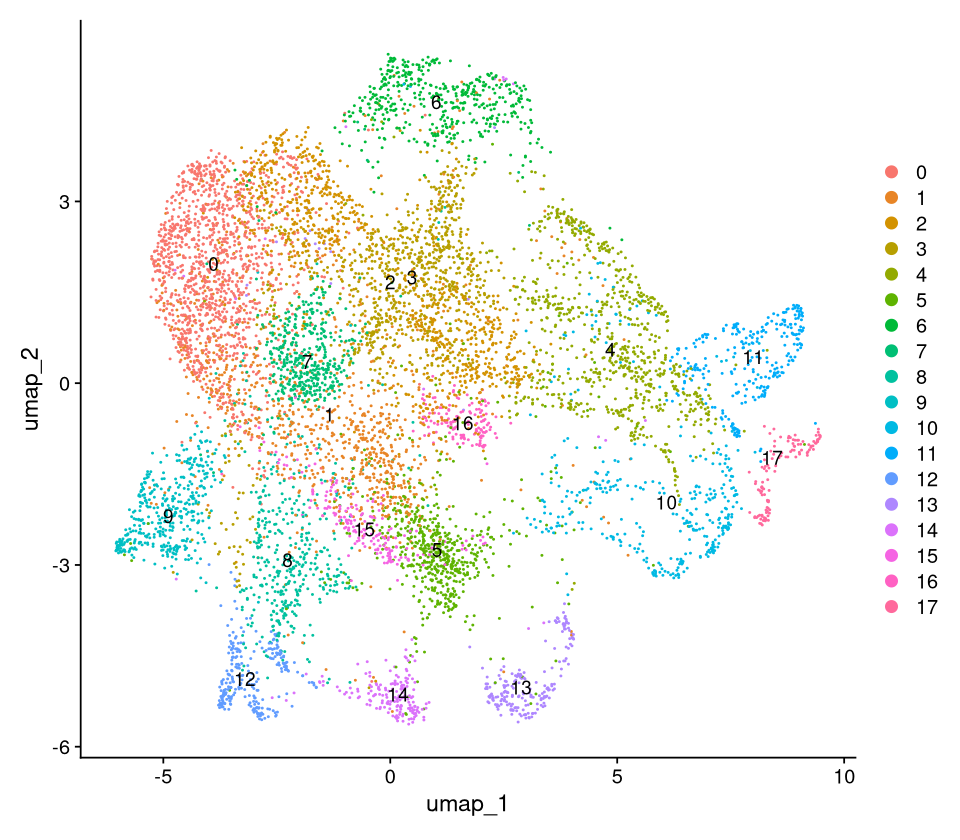

In [134]:
options(repr.plot.width = 8, repr.plot.height = 7)
DimPlot(obj.merge, reduction = "umap", label = TRUE)

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


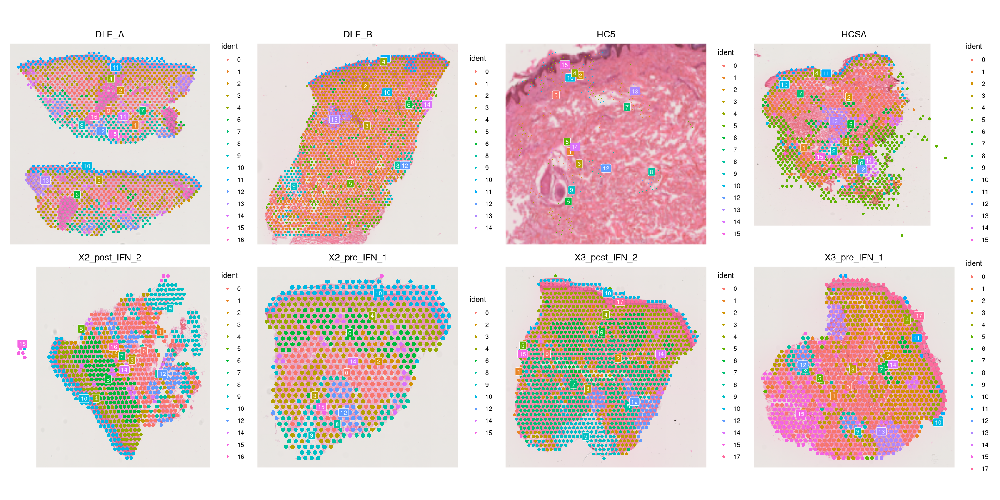

In [136]:
options(repr.plot.width = 20, repr.plot.height = 10)
SpatialDimPlot(obj.merge, label = TRUE, label.size = 3, ncol = 4)

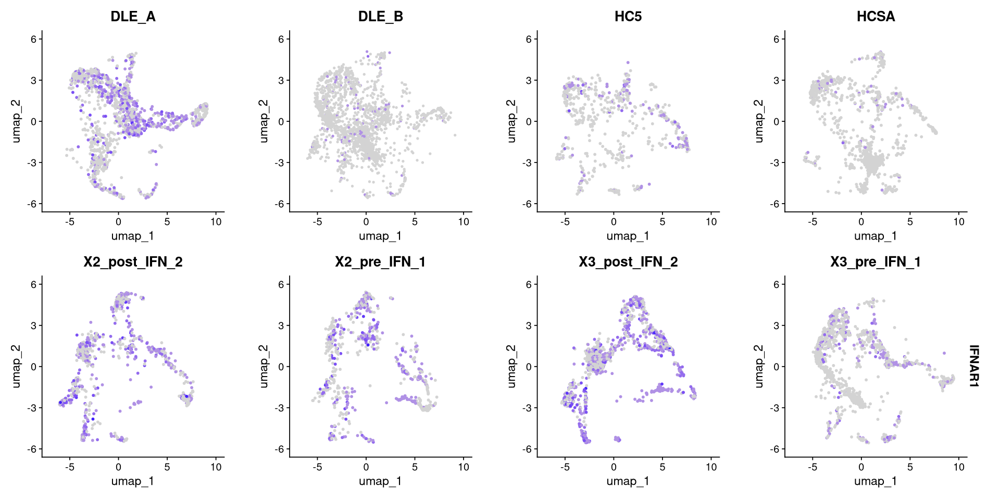

In [126]:
options(repr.plot.width = 16, repr.plot.height = 8)
FeaturePlot(obj.merge, features = c("IFNAR1"), reduction ="umap", split.by ="SAMPLE") +
    patchwork::plot_layout(ncol = 4, nrow = 2)

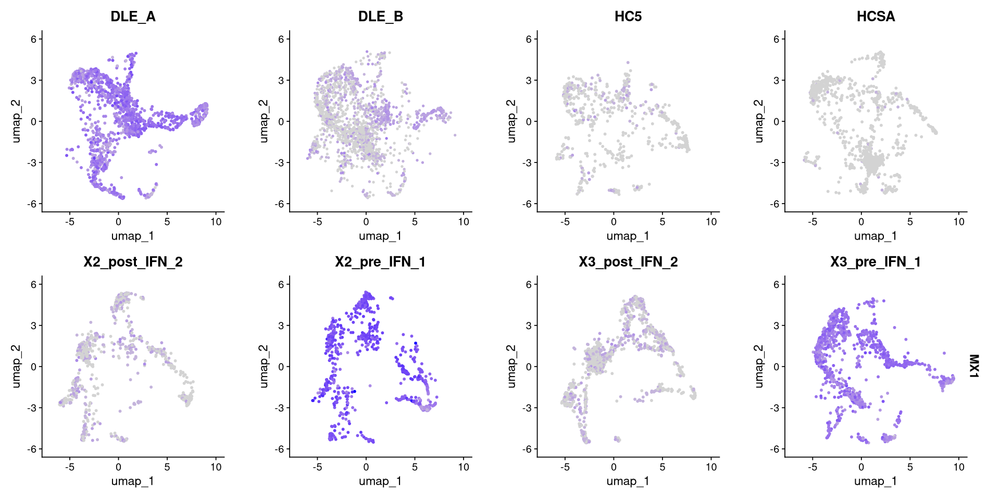

In [127]:
options(repr.plot.width = 16, repr.plot.height = 8)
FeaturePlot(obj.merge, features = c("MX1"), reduction ="umap", split.by ="SAMPLE") +
    patchwork::plot_layout(ncol = 4, nrow = 2)

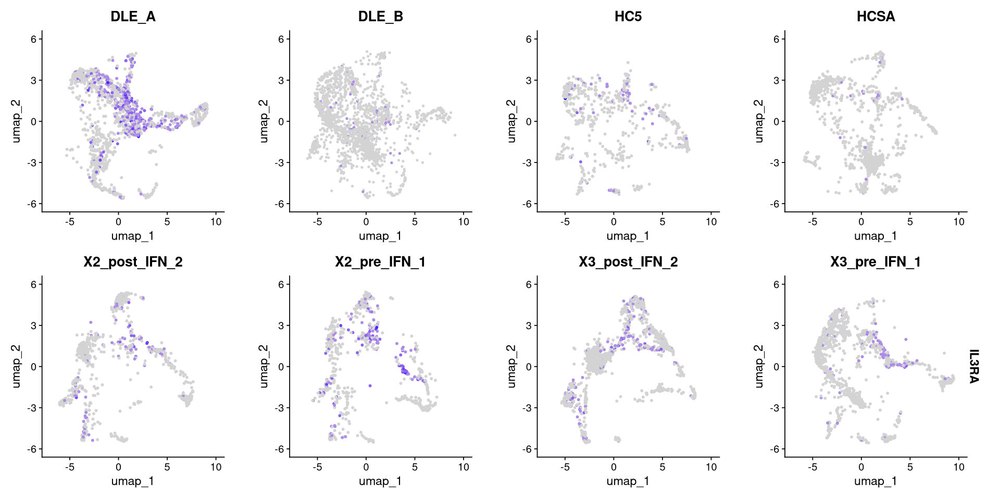

In [128]:
options(repr.plot.width = 16, repr.plot.height = 8)
FeaturePlot(obj.merge, features = c("IL3RA"), reduction ="umap", split.by ="SAMPLE") +
    patchwork::plot_layout(ncol = 4, nrow = 2)

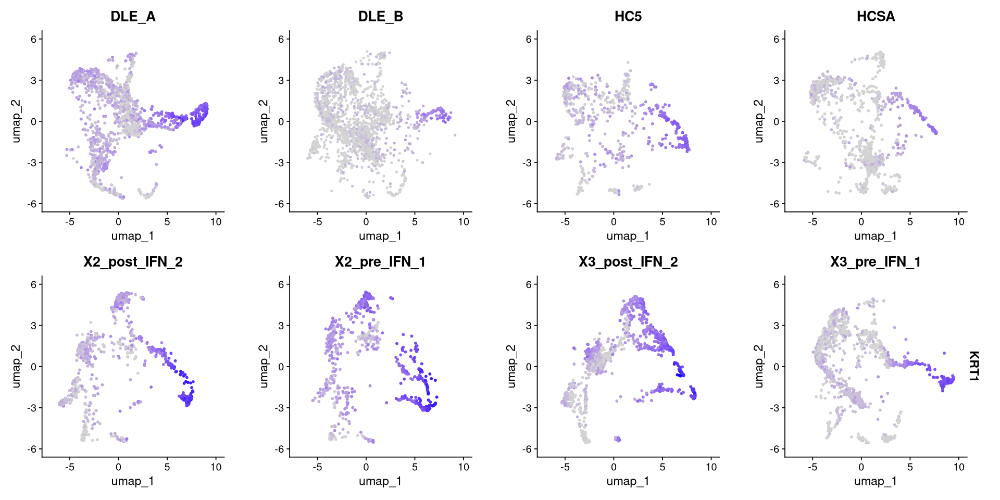

In [129]:
options(repr.plot.width = 16, repr.plot.height = 8)
FeaturePlot(obj.merge, features = c("KRT1"), reduction ="umap", split.by ="SAMPLE") +
    patchwork::plot_layout(ncol = 4, nrow = 2)

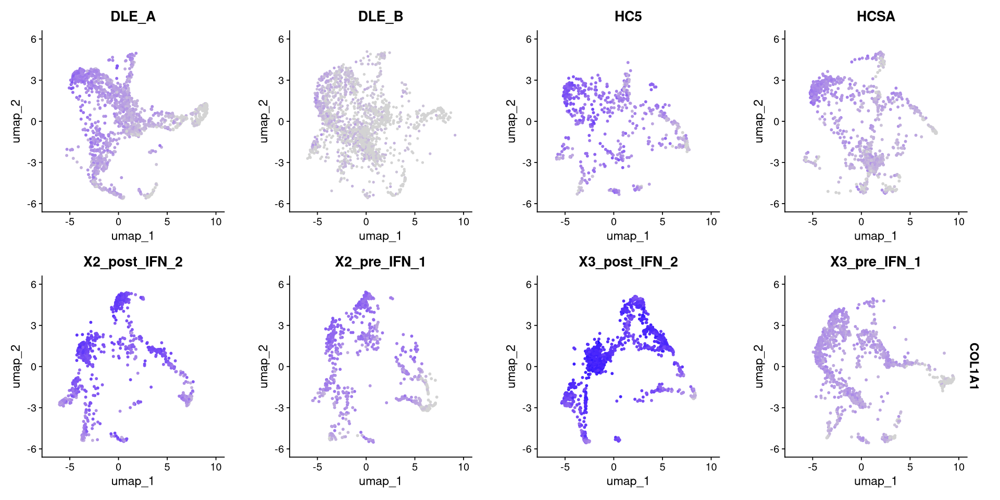

In [130]:
options(repr.plot.width = 16, repr.plot.height = 8)
FeaturePlot(obj.merge, features = c("COL1A1"), reduction ="umap", split.by ="SAMPLE") +
    patchwork::plot_layout(ncol = 4, nrow = 2)

# Integrate Merge

In [24]:
features <- SelectIntegrationFeatures(object.list = obj_list)

In [25]:
obj_list <- lapply(X = obj_list, FUN = function(x) {
    x <- ScaleData(x, features = features, verbose = FALSE)
    x <- RunPCA(x, features = features, verbose = FALSE)
})

In [26]:
obj_list <- PrepSCTIntegration(object.list = obj_list , anchor.features = features)

In [27]:
immune.anchors <- FindIntegrationAnchors(object.list = obj_list, anchor.features = features, normalization.method = "SCT")

Warning message in CheckDuplicateCellNames(object.list = object.list):
“Some cell names are duplicated across objects provided. Renaming to enforce unique cell names.”
Finding all pairwise anchors

Running CCA

Merging objects

Warning message:
“Adding image data that isn't associated with any assays”
Warning message:
“Adding image data that isn't associated with any assays”
Warning message:
“Key ‘slice1_’ taken, using ‘slice12_’ instead”
Finding neighborhoods

Finding anchors

	Found 2446 anchors

Filtering anchors

	Retained 1087 anchors

Running CCA

Merging objects

Warning message:
“Adding image data that isn't associated with any assays”
Warning message:
“Adding image data that isn't associated with any assays”
Warning message:
“Key ‘slice1_’ taken, using ‘slice12_’ instead”
Finding neighborhoods

Finding anchors

	Found 2289 anchors

Filtering anchors

	Retained 1314 anchors

Running CCA

Merging objects

Warning message:
“Adding image data that isn't associated with any assays”

In [28]:
immune.combined <- IntegrateData(anchorset = immune.anchors, normalization.method = "SCT")
DefaultAssay(immune.combined) <- "integrated"

[1] 1


Warning message:
“Different cells and/or features from existing assay SCT”
Warning message:
“Layer counts isn't present in the assay object; returning NULL”


[1] 2


Warning message:
“Different cells and/or features from existing assay SCT”
Warning message:
“Layer counts isn't present in the assay object; returning NULL”


[1] 3


Warning message:
“Different cells and/or features from existing assay SCT”
Warning message:
“Layer counts isn't present in the assay object; returning NULL”


[1] 4


Warning message:
“Different cells and/or features from existing assay SCT”
Warning message:
“Layer counts isn't present in the assay object; returning NULL”


[1] 5


Warning message:
“Different cells and/or features from existing assay SCT”
Warning message:
“Layer counts isn't present in the assay object; returning NULL”


[1] 6


Warning message:
“Different cells and/or features from existing assay SCT”
Warning message:
“Layer counts isn't present in the assay object; returning NULL”


[1] 7


Warning message:
“Different cells and/or features from existing assay SCT”
Warning message:
“Layer counts isn't present in the assay object; returning NULL”


[1] 8


Warning message:
“Different cells and/or features from existing assay SCT”
Warning message:
“Layer counts isn't present in the assay object; returning NULL”


[1] 9


Warning message:
“Different cells and/or features from existing assay SCT”
Warning message:
“Layer counts isn't present in the assay object; returning NULL”


[1] 10


Warning message:
“Different cells and/or features from existing assay SCT”
Warning message:
“Layer counts isn't present in the assay object; returning NULL”


[1] 11


Warning message:
“Different cells and/or features from existing assay SCT”
Warning message:
“Layer counts isn't present in the assay object; returning NULL”


[1] 12


Warning message:
“Different cells and/or features from existing assay SCT”
Warning message:
“Layer counts isn't present in the assay object; returning NULL”
Merging dataset 10 into 2

Warning message:
“Adding image data that isn't associated with any assays”
Warning message:
“Adding image data that isn't associated with any assays”
Warning message:
“Key ‘slice1_’ taken, using ‘slice12_’ instead”
Extracting anchors for merged samples

Warning message:
“Adding image data that isn't associated with any assays”
Warning message:
“Adding image data that isn't associated with any assays”
Warning message:
“Key ‘slice1_’ taken, using ‘slice12_’ instead”
Finding integration vectors

Finding integration vector weights

Integrating data

Warning message:
“Layer counts isn't present in the assay object; returning NULL”
Merging dataset 5 into 3

Warning message:
“Adding image data that isn't associated with any assays”
Warning message:
“Adding image data that isn't associated with any assays”
Warnin

In [29]:
# Run the standard workflow for visualization and clustering
immune.combined <- ScaleData(immune.combined, verbose = FALSE)
immune.combined <- RunPCA(immune.combined, npcs = 30, verbose = FALSE)
immune.combined <- RunUMAP(immune.combined, reduction = "pca", dims = 1:30)
immune.combined <- FindNeighbors(immune.combined, reduction = "pca", dims = 1:30)
immune.combined <- FindClusters(immune.combined, resolution = 0.5)

21:38:24 UMAP embedding parameters a = 0.9922 b = 1.112

21:38:24 Read 13861 rows and found 30 numeric columns

21:38:24 Using Annoy for neighbor search, n_neighbors = 30

21:38:24 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

21:38:26 Writing NN index file to temp file /tmp/RtmpWWcL5j/file62c082da21a8d

21:38:26 Searching Annoy index using 1 thread, search_k = 3000

21:38:31 Annoy recall = 100%

21:38:32 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

21:38:33 Initializing from normalized Laplacian + noise (using RSpectra)

21:38:33 Commencing optimization for 200 epochs, with 653508 positive edges

21:38:41 Optimization finished

Computing nearest neighbor graph

Computing SNN



Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 13861
Number of edges: 660879

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8873
Number of communities: 17
Elapsed time: 3 seconds


In [30]:
names(immune.combined@images) <- names(obj_list)

In [69]:
saveRDS(immune.combined, file.path(output_dir, "immune.combined.rds"))

# Load Dataset

In [11]:
immune.combined <- readRDS(file.path(output_dir, "immune.combined.rds"))

In [618]:
immune.combined@meta.data  <- immune.combined@meta.data %>%
    left_join(meta_df %>% select(SAMPLE, DISEASE))

Joining with `by = join_by(SAMPLE)`


# Analysis Core

### Initial

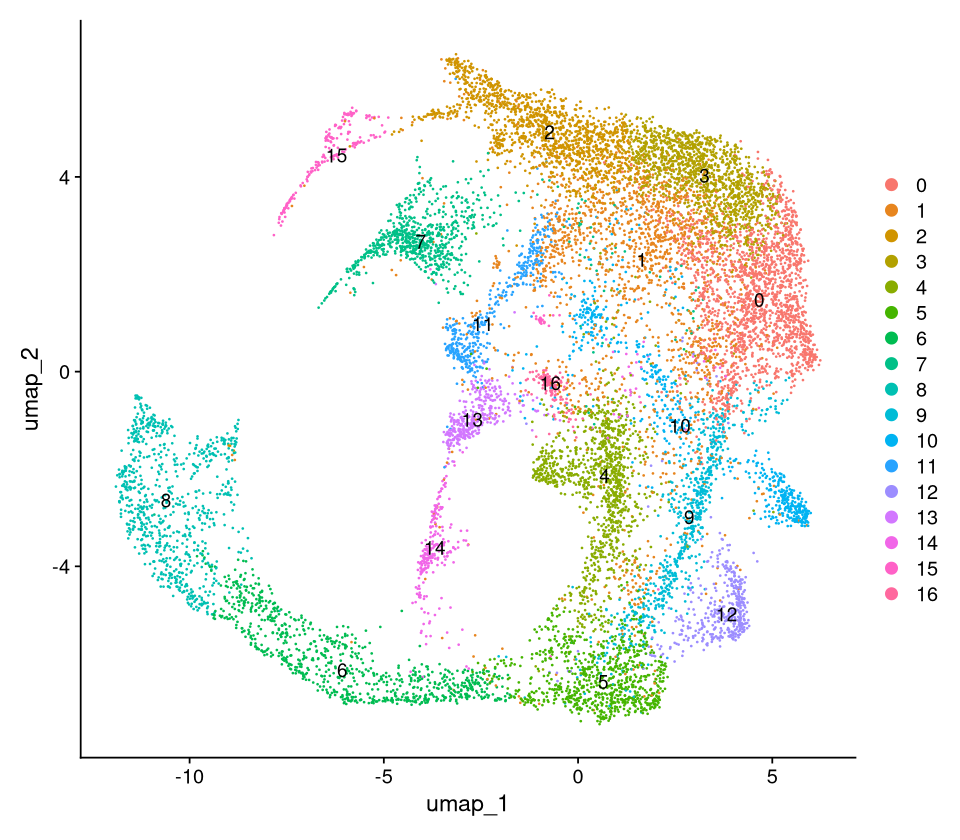

In [67]:
options(repr.plot.width = 8, repr.plot.height = 7)
DimPlot(immune.combined, reduction = "umap", label = TRUE)

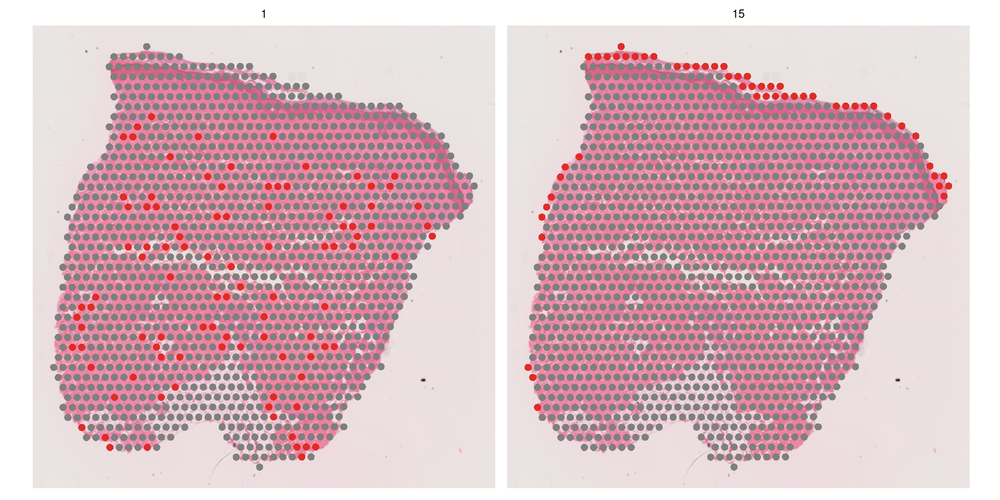

In [211]:
#load row 11
options(repr.plot.width = 16, repr.plot.height = 8)
SpatialDimPlot(immune.combined, cells.highlight = CellsByIdentities(object = immune.combined, idents = c(1,15)), 
               facet.highlight = TRUE, ncol = 2,  images = "X3_post_IFN_2")

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


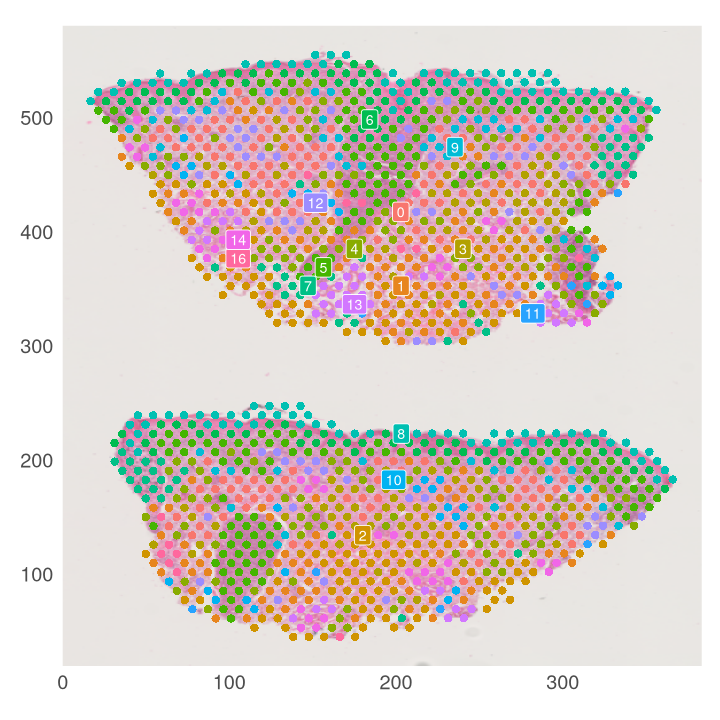

In [193]:
#options(repr.plot.width = 6, repr.plot.height = 6)
SpatialPlot(immune.combined, label = TRUE, label.size = 3, images = "DLE_A") + 
    theme(legend.position="none", axis.text.x = element_text(size =12), , axis.text.y = element_text(size =12))

## UNDER CONSTRUCTION, TRYING TO ADJUST OVERLAY BW PICTURE AND SPATIAL TX
- The main issue is how to overlay the raster image with the geom_dot plot, there appears to be a subtle correction factor when plotting

In [530]:
select_image <- immune.combined@images$X3_post_IFN_2

In [528]:
centroid_df <- select_image@boundaries$centroids@coords %>% 
    data.frame() %>%
    mutate(cells = select_image @boundaries$centroids@cells) %>%
    mutate(CLUSTER = paste0("g", immune.combined@active.ident[cells])) %>%
    left_join(final_assignment_df %>% select(CLUSTER, FINAL_ASSIGNMENT) %>% na.omit())

Joining with `by = join_by(CLUSTER)`
Warning message in left_join(., final_assignment_df %>% select(CLUSTER, FINAL_ASSIGNMENT) %>% :
“Detected an unexpected many-to-many relationship between `x` and `y`.
ℹ Row 1 of `x` matches multiple rows in `y`.
ℹ Row 9 of `y` matches multiple rows in `x`.
ℹ If a many-to-many relationship is expected, set `relationship = "many-to-many"` to silence this warning.”


In [531]:
bbox <- select_image@boundaries$centroids@bbox
img <- select_image@image
#centroid_coords <- select_image@boundaries$centroids@coords

In [532]:
x.min <- bbox["x","min"]
x.max <- bbox["x","max"]
y.min <- bbox["y","min"]
y.max <- bbox["y","max"]

In [533]:
bbox

,min,max
x,654,6577
y,822,8115


In [534]:
# y-axis
y_correction = (x.max+x.min)/mean(centroid_coords[,"y"])/1.8

In [535]:
y_correction

[1] 0.9851342

In [536]:
# x axis
x_correction = (y.max+y.min)/mean(centroid_coords[,"x"])/100

In [537]:
x_correction

[1] 0.02480707

In [538]:
label_df <- centroid_df %>%
    group_by(CLUSTER) %>%
    summarize(projection_1 = mean(x), projection_2 = mean(y)) %>% ungroup()

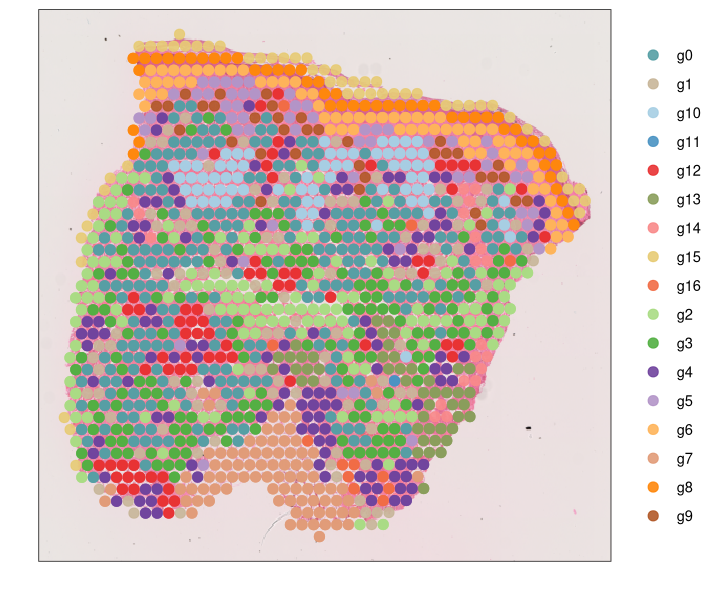

In [556]:
# label_df <- projection_df 
options(repr.plot.width = 6, repr.plot.height = 5)

p <- centroid_df %>% ggplot(aes(x=y, y=x.max-x+x.min, color=CLUSTER)) + 
    #annotation_raster(raster = img, -Inf, Inf, -Inf, Inf) +
    #annotation_raster(raster = img, 0, 8115-822, 0, 6577-654) +
    annotation_raster(raster = img, 0, (y.max+y.min)*y_correction, (x.max+x.min)*x_correction, x.max+x.min) +
    theme_bw() +
    theme(legend.position="right", legend.title=element_blank(), axis.title.x=element_text(size=12), axis.title.y=element_text(size=12),
             axis.text.x=element_blank(),
            axis.ticks.x=element_blank(),
          axis.text.y=element_blank(),
            axis.ticks.y=element_blank(),panel.grid.major=element_blank(), panel.grid.minor=element_blank()
         ) +
    scale_color_manual(values=CLUSTER_COLORS) +
    geom_point(size = 2.5, alpha = 0.9) +
    xlab("") + ylab("") #+
    #geom_label(data=label_df, aes(x=projection_1, y=projection_2, label = CLUSTER), size = 3, alpha = 0.8)
plot(p)

In [557]:
plotFigure(p, file.path(plot_dir, "cluster_overlay_H&E.pdf"), 6, 5)

png 
  2

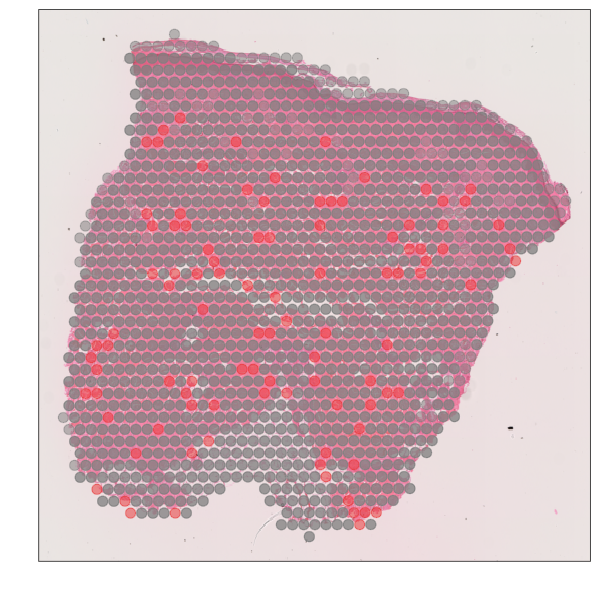

In [558]:
options(repr.plot.width = 5, repr.plot.height = 5)


p <- centroid_df %>% mutate(BOOL = CLUSTER != "g1") %>% ggplot(aes(x=y, y=x.max-x+x.min, color=BOOL)) + 
    #annotation_raster(raster = img, -Inf, Inf, -Inf, Inf) +
    #annotation_raster(raster = img, 0, 8115-822, 0, 6577-654) +
    annotation_raster(raster = img, 0, (y.max+y.min)*y_correction, (x.max+x.min)*x_correction, x.max+x.min) +
    theme_bw() +
    theme(legend.position="none", legend.title=element_blank(), axis.title.x=element_text(size=12), axis.title.y=element_text(size=12),
             axis.text.x=element_blank(),
            axis.ticks.x=element_blank(),
          axis.text.y=element_blank(),
            axis.ticks.y=element_blank(),panel.grid.major=element_blank(), panel.grid.minor=element_blank()
         ) +
    scale_color_manual(values=c("#E73233", "#808080")) +
    geom_point(size = 2.5, alpha = 0.5) +
    xlab("") + ylab("") #+
    #geom_label(data=label_df, aes(x=projection_1, y=projection_2, label = CLUSTER), size = 3, alpha = 0.8)
plot(p)

In [559]:
plotFigure(p, file.path(plot_dir, "g1_overlay_H&E.pdf"), 5, 5)

png 
  2

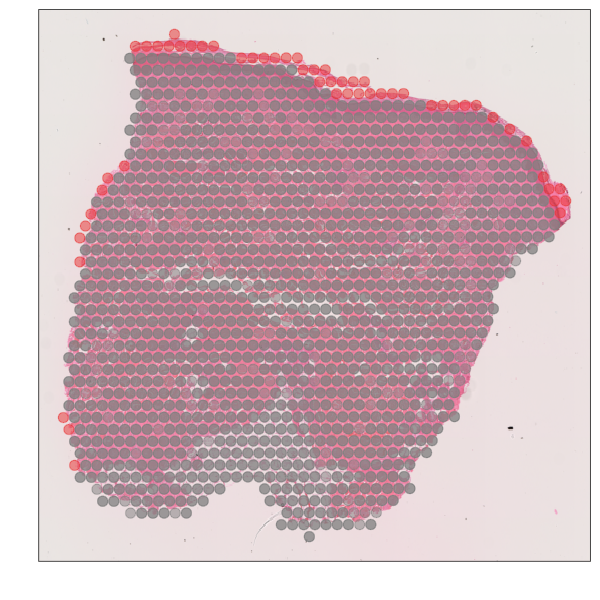

In [560]:
options(repr.plot.width = 5, repr.plot.height = 5)


p <- centroid_df %>% mutate(BOOL = CLUSTER != "g15") %>% ggplot(aes(x=y, y=x.max-x+x.min, color=BOOL)) + 
    #annotation_raster(raster = img, -Inf, Inf, -Inf, Inf) +
    #annotation_raster(raster = img, 0, 8115-822, 0, 6577-654) +
    annotation_raster(raster = img, 0, (y.max+y.min)*y_correction, (x.max+x.min)*x_correction, x.max+x.min) +
    theme_bw() +
    theme(legend.position="none", legend.title=element_blank(), axis.title.x=element_text(size=12), axis.title.y=element_text(size=12),
             axis.text.x=element_blank(),
            axis.ticks.x=element_blank(),
          axis.text.y=element_blank(),
            axis.ticks.y=element_blank(),panel.grid.major=element_blank(), panel.grid.minor=element_blank()
         ) +
    scale_color_manual(values=c("#E73233", "#808080")) +
    geom_point(size = 2.5, alpha = 0.5) +
    xlab("") + ylab("") #+
    #geom_label(data=label_df, aes(x=projection_1, y=projection_2, label = CLUSTER), size = 3, alpha = 0.8)
plot(p)

In [561]:
plotFigure(p, file.path(plot_dir, "g15_overlay_H&E.pdf"), 5, 5)

png 
  2

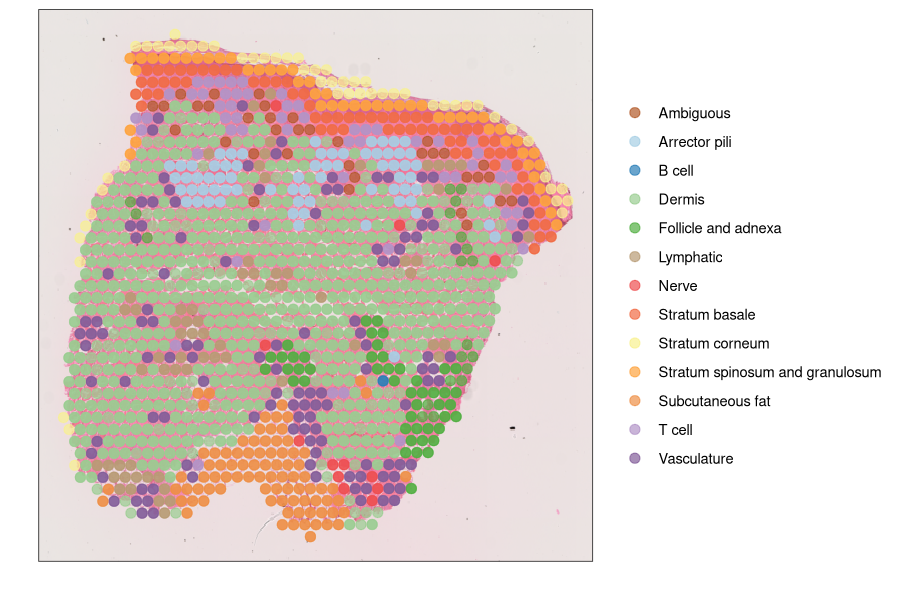

In [548]:
options(repr.plot.width = 7.5, repr.plot.height = 5)

p <- centroid_df %>% ggplot(aes(x=y, y=x.max-x+x.min, color=FINAL_ASSIGNMENT)) + 
    #annotation_raster(raster = img, -Inf, Inf, -Inf, Inf) +
    #annotation_raster(raster = img, 0, 8115-822, 0, 6577-654) +
    annotation_raster(raster = img, 0, (y.max+y.min)*y_correction, (x.max+x.min)*x_correction, x.max+x.min) +
    theme_bw() +
    theme(legend.position="right", legend.title=element_blank(), axis.title.x=element_text(size=12), axis.title.y=element_text(size=12),
             axis.text.x=element_blank(),
            axis.ticks.x=element_blank(),
          axis.text.y=element_blank(),
            axis.ticks.y=element_blank(),panel.grid.major=element_blank(), panel.grid.minor=element_blank()
         ) +
    scale_color_manual(values=FINAL_ASSIGNMENT_COLORS) +
    geom_point(size = 2.5, alpha = 0.7) +
    xlab("") + ylab("") #+
    #geom_label(data=label_df, aes(x=projection_1, y=projection_2, label = CLUSTER), size = 3, alpha = 0.8)
plot(p)

In [549]:
plotFigure(p, file.path(plot_dir, "assignment_overlay_H&E.pdf"), 8, 5)

png 
  2

In [371]:
#immune.combined@assays$Spatial@layers$counts.11 %>% head()

## DETOUR

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


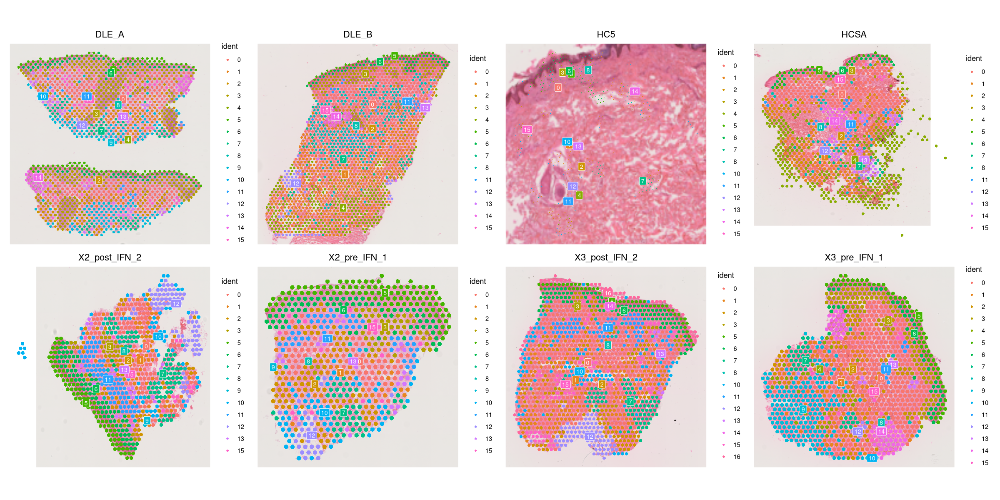

In [152]:
options(repr.plot.width = 20, repr.plot.height = 10)
SpatialDimPlot(immune.combined, label = TRUE, label.size = 3, ncol = 4)

Warning message:
“No layers found matching search pattern provided”
Warning message:
“Could not find MX1 in the default search locations, found in ‘SCT’ assay instead”


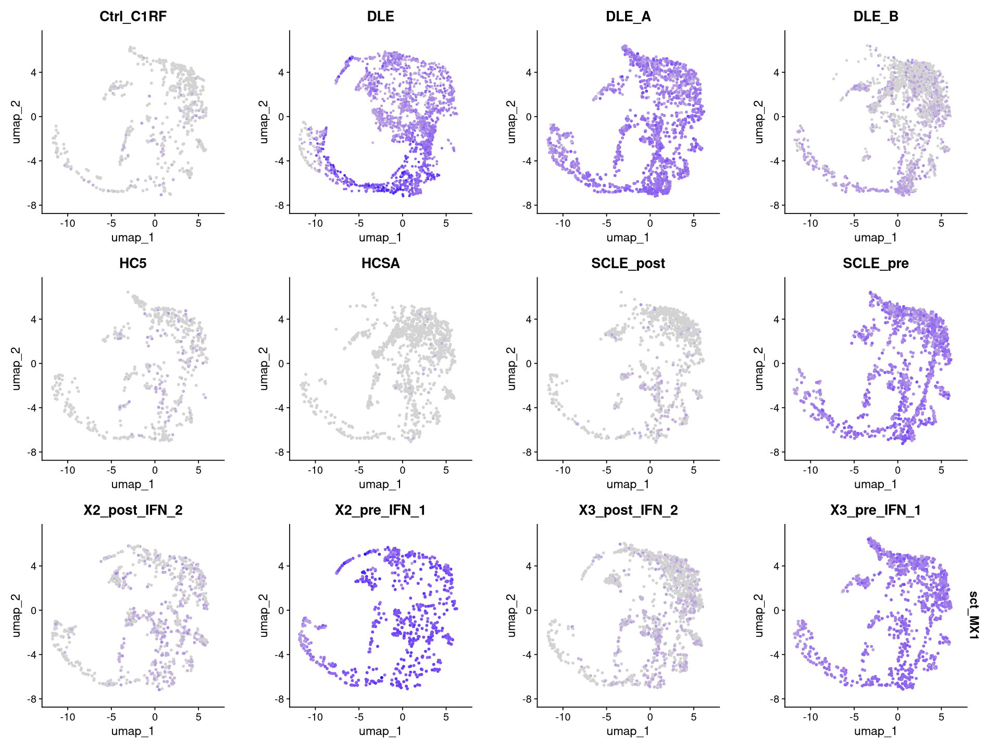

In [63]:
options(repr.plot.width = 16, repr.plot.height = 12)
FeaturePlot(immune.combined, features = c("MX1"), reduction ="umap", split.by ="SAMPLE") +
    patchwork::plot_layout(ncol = 4, nrow = 3)

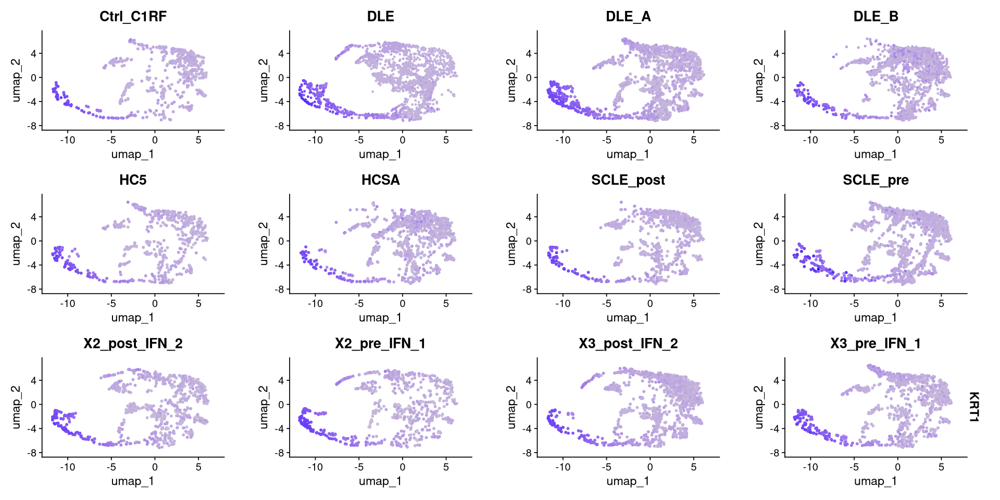

In [65]:
options(repr.plot.width = 16, repr.plot.height = 8)
FeaturePlot(immune.combined, features = c("KRT1"), reduction ="umap", split.by ="SAMPLE") +
    patchwork::plot_layout(ncol = 4, nrow = 3)

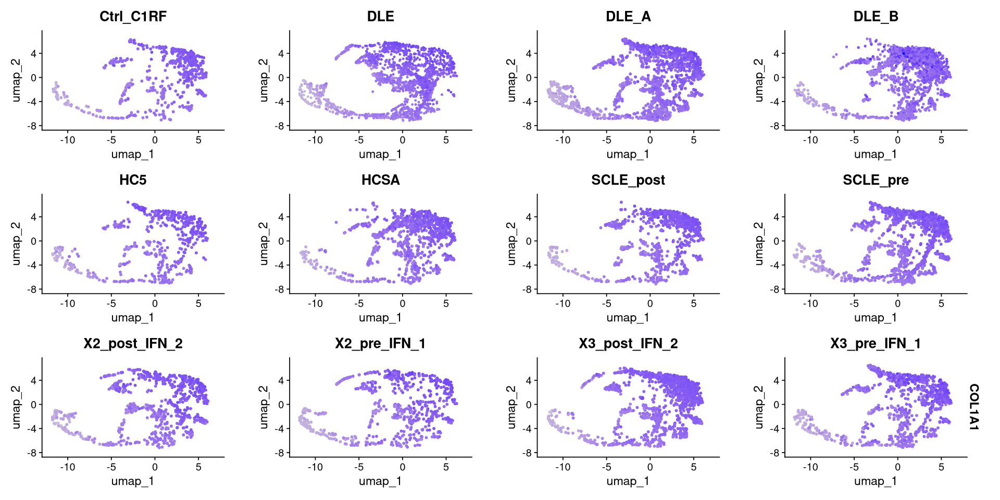

In [66]:
options(repr.plot.width = 16, repr.plot.height = 8)
FeaturePlot(immune.combined, features = c("COL1A1"), reduction ="umap", split.by ="SAMPLE") +
    patchwork::plot_layout(ncol = 4, nrow = 3)

Warning message:
“No layers found matching search pattern provided”
Warning message:
“Could not find CD3E in the default search locations, found in ‘SCT’ assay instead”


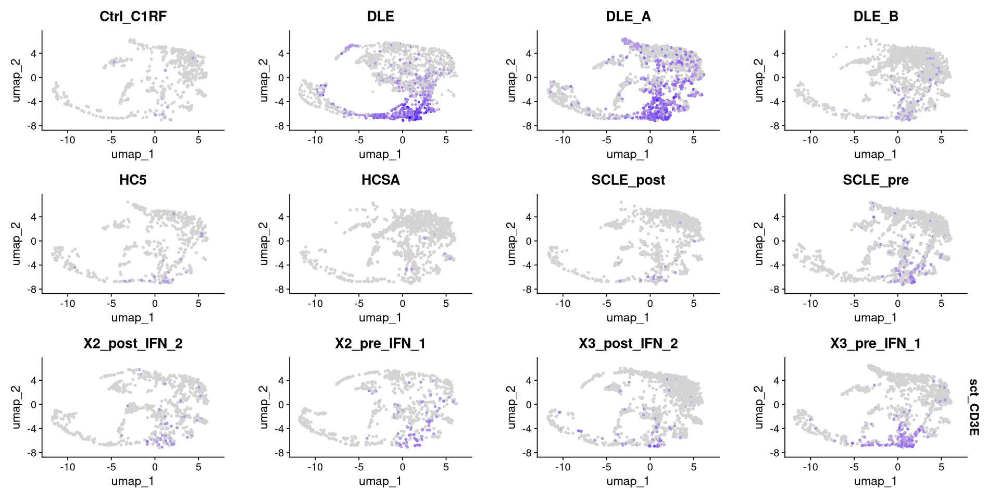

In [68]:
options(repr.plot.width = 16, repr.plot.height = 8)
FeaturePlot(immune.combined, features = c("CD3E"), reduction ="umap", split.by ="SAMPLE") +
    patchwork::plot_layout(ncol = 4, nrow = 3)

### Publication quality

Joining with `by = join_by(LOAD_ROW)`


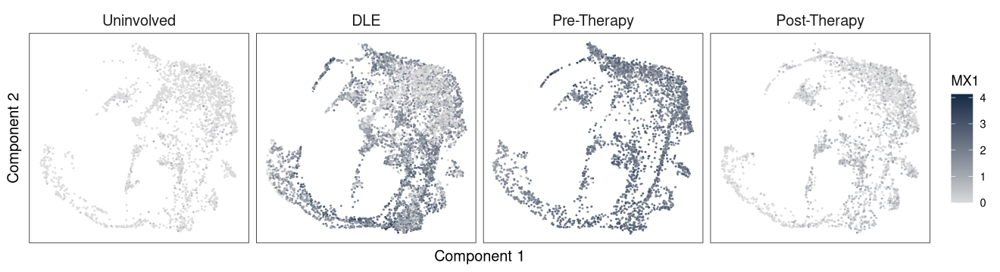

In [338]:
options(repr.plot.width = 11, repr.plot.height = 3)
gene_name <- "MX1"
expr_vec <- immune.combined@assays$SCT@data[gene_name,]
projection_df <- data.frame(immune.combined@reductions$umap@cell.embeddings) %>% 
    rownames_to_column("cell_id") %>% rowwise() %>%
    mutate(LOAD_ROW = strsplit(cell_id, split = "_")[[1]][2]) %>% 
    left_join(meta_df %>% select(LOAD_ROW, SAMPLE, DISEASE)) %>%
    mutate(DISEASE_FANCY = factor(DISEASE_NAMES[DISEASE], levels=DISEASE_ORDER))

p <- ggplot(projection_df, aes(x = umap_1, y = umap_2)) + 
        theme_bw() +
        theme( axis.title.x=element_text(size=12), axis.title.y=element_text(size=12),
                  strip.background = element_blank(),
                  strip.text=element_text(size=12),
                 axis.text.x=element_blank(),
                axis.ticks.x=element_blank(),
              axis.text.y=element_blank(),
                axis.ticks.y=element_blank(),
              panel.grid.major = element_blank(),
              panel.grid.minor = element_blank()
             ) +
        scale_colour_gradient2(low = "#EBEBEB", mid = "#D9D9D9",
          high = "#132B43", name=gene_name) +
        geom_point(size = 0.2, aes(color=as.numeric(expr_vec)), alpha = 0.8) +
        xlab("Component 1") +
        ylab("Component 2") + 
        facet_wrap(. ~DISEASE_FANCY, nrow=1, ncol=4)
plot(p)

In [341]:
plotFigure(p, file.path(plot_dir, "mx1_umap.pdf"), 10, 2.5)

png 
  2

Joining with `by = join_by(LOAD_ROW)`


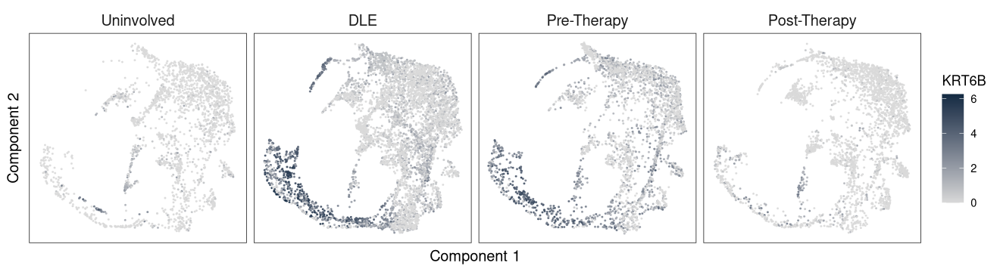

In [347]:
options(repr.plot.width = 11, repr.plot.height = 3)
gene_name <- "KRT6B"
expr_vec <- immune.combined@assays$SCT@data[gene_name,]
projection_df <- data.frame(immune.combined@reductions$umap@cell.embeddings) %>% 
    rownames_to_column("cell_id") %>% rowwise() %>%
    mutate(LOAD_ROW = strsplit(cell_id, split = "_")[[1]][2]) %>% 
    left_join(meta_df %>% select(LOAD_ROW, SAMPLE, DISEASE)) %>%
    mutate(DISEASE_FANCY = factor(DISEASE_NAMES[DISEASE], levels=DISEASE_ORDER))

p <- ggplot(projection_df, aes(x = umap_1, y = umap_2)) + 
        theme_bw() +
        theme( axis.title.x=element_text(size=12), axis.title.y=element_text(size=12),
                  strip.background = element_blank(),
                  strip.text=element_text(size=12),
                 axis.text.x=element_blank(),
                axis.ticks.x=element_blank(),
              axis.text.y=element_blank(),
                axis.ticks.y=element_blank(),
              panel.grid.major = element_blank(),
              panel.grid.minor = element_blank()
             ) +
        scale_colour_gradient2(low = "#EBEBEB", mid = "#D9D9D9",
          high = "#132B43", name=gene_name) +
        geom_point(size = 0.2, aes(color=as.numeric(expr_vec)), alpha = 0.8) +
        xlab("Component 1") +
        ylab("Component 2") + 
        facet_wrap(. ~DISEASE_FANCY, nrow=1, ncol=4)
plot(p)

In [348]:
plotFigure(p, file.path(plot_dir, "krt6b_umap.pdf"), 10, 2.5)

png 
  2

Joining with `by = join_by(LOAD_ROW)`


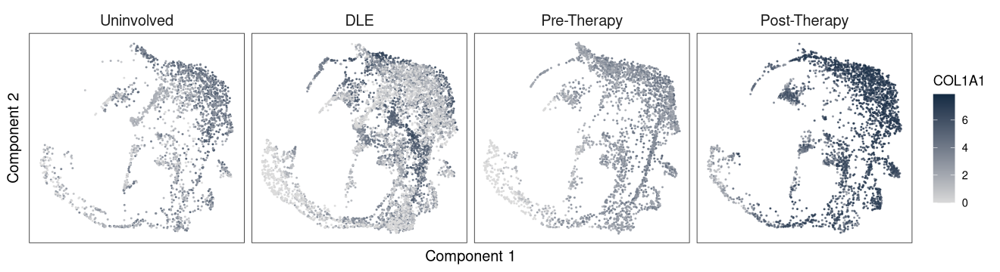

In [345]:
options(repr.plot.width = 11, repr.plot.height = 3)
gene_name <- "COL1A1"
expr_vec <- immune.combined@assays$SCT@data[gene_name,]
projection_df <- data.frame(immune.combined@reductions$umap@cell.embeddings) %>% 
    rownames_to_column("cell_id") %>% rowwise() %>%
    mutate(LOAD_ROW = strsplit(cell_id, split = "_")[[1]][2]) %>% 
    left_join(meta_df %>% select(LOAD_ROW, SAMPLE, DISEASE)) %>%
    mutate(DISEASE_FANCY = factor(DISEASE_NAMES[DISEASE], levels=DISEASE_ORDER))

p <- ggplot(projection_df, aes(x = umap_1, y = umap_2)) + 
        theme_bw() +
        theme( axis.title.x=element_text(size=12), axis.title.y=element_text(size=12),
                  strip.background = element_blank(),
                  strip.text=element_text(size=12),
                 axis.text.x=element_blank(),
                axis.ticks.x=element_blank(),
              axis.text.y=element_blank(),
                axis.ticks.y=element_blank(),
              panel.grid.major = element_blank(),
              panel.grid.minor = element_blank()
             ) +
        scale_colour_gradient2(low = "#EBEBEB", mid = "#D9D9D9",
          high = "#132B43", name=gene_name) +
        geom_point(size = 0.2, aes(color=as.numeric(expr_vec)), alpha = 0.8) +
        xlab("Component 1") +
        ylab("Component 2") + 
        facet_wrap(. ~DISEASE_FANCY, nrow=1, ncol=4)
plot(p)

In [346]:
plotFigure(p, file.path(plot_dir, "col1_umap.pdf"), 10, 2.5)

png 
  2

Joining with `by = join_by(LOAD_ROW)`


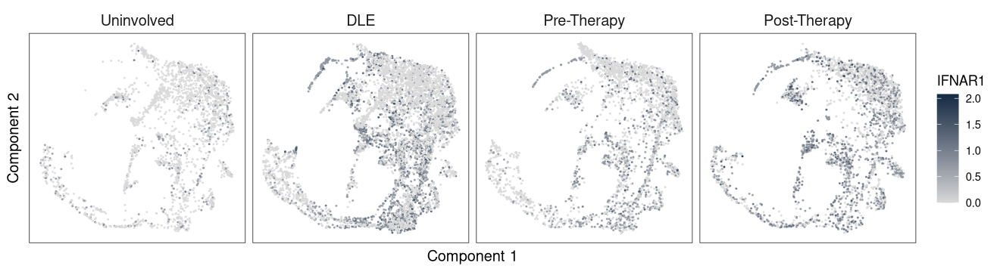

In [349]:
options(repr.plot.width = 11, repr.plot.height = 3)
gene_name <- "IFNAR1"
expr_vec <- immune.combined@assays$SCT@data[gene_name,]
projection_df <- data.frame(immune.combined@reductions$umap@cell.embeddings) %>% 
    rownames_to_column("cell_id") %>% rowwise() %>%
    mutate(LOAD_ROW = strsplit(cell_id, split = "_")[[1]][2]) %>% 
    left_join(meta_df %>% select(LOAD_ROW, SAMPLE, DISEASE)) %>%
    mutate(DISEASE_FANCY = factor(DISEASE_NAMES[DISEASE], levels=DISEASE_ORDER))

p <- ggplot(projection_df, aes(x = umap_1, y = umap_2)) + 
        theme_bw() +
        theme( axis.title.x=element_text(size=12), axis.title.y=element_text(size=12),
                  strip.background = element_blank(),
                  strip.text=element_text(size=12),
                 axis.text.x=element_blank(),
                axis.ticks.x=element_blank(),
              axis.text.y=element_blank(),
                axis.ticks.y=element_blank(),
              panel.grid.major = element_blank(),
              panel.grid.minor = element_blank()
             ) +
        scale_colour_gradient2(low = "#EBEBEB", mid = "#D9D9D9",
          high = "#132B43", name=gene_name) +
        geom_point(size = 0.2, aes(color=as.numeric(expr_vec)), alpha = 0.8) +
        xlab("Component 1") +
        ylab("Component 2") + 
        facet_wrap(. ~DISEASE_FANCY, nrow=1, ncol=4)
plot(p)

In [350]:
plotFigure(p, file.path(plot_dir, "ifnar1_umap.pdf"), 10, 2.5)

png 
  2

Joining with `by = join_by(LOAD_ROW)`


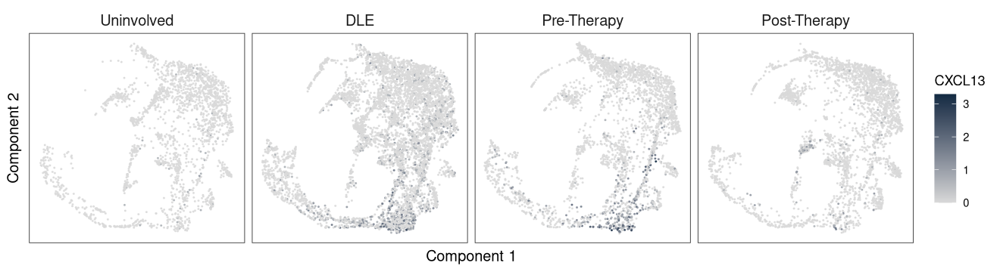

In [351]:
options(repr.plot.width = 11, repr.plot.height = 3)
gene_name <- "CXCL13"
expr_vec <- immune.combined@assays$SCT@data[gene_name,]
projection_df <- data.frame(immune.combined@reductions$umap@cell.embeddings) %>% 
    rownames_to_column("cell_id") %>% rowwise() %>%
    mutate(LOAD_ROW = strsplit(cell_id, split = "_")[[1]][2]) %>% 
    left_join(meta_df %>% select(LOAD_ROW, SAMPLE, DISEASE)) %>%
    mutate(DISEASE_FANCY = factor(DISEASE_NAMES[DISEASE], levels=DISEASE_ORDER))

p <- ggplot(projection_df, aes(x = umap_1, y = umap_2)) + 
        theme_bw() +
        theme( axis.title.x=element_text(size=12), axis.title.y=element_text(size=12),
                  strip.background = element_blank(),
                  strip.text=element_text(size=12),
                 axis.text.x=element_blank(),
                axis.ticks.x=element_blank(),
              axis.text.y=element_blank(),
                axis.ticks.y=element_blank(),
              panel.grid.major = element_blank(),
              panel.grid.minor = element_blank()
             ) +
        scale_colour_gradient2(low = "#EBEBEB", mid = "#D9D9D9",
          high = "#132B43", name=gene_name) +
        geom_point(size = 0.2, aes(color=as.numeric(expr_vec)), alpha = 0.8) +
        xlab("Component 1") +
        ylab("Component 2") + 
        facet_wrap(. ~DISEASE_FANCY, nrow=1, ncol=4)
plot(p)

In [352]:
plotFigure(p, file.path(plot_dir, "cxcl13_umap.pdf"), 10, 2.5)

png 
  2

# Define microarchitecture

In [434]:
pseudo_immune_clusters <- AggregateExpression(immune.combined, assays = "SCT", 
                                   return.seurat = T, group.by = c("seurat_clusters"))

First group.by variable `seurat_clusters` starts with a number, appending `g` to ensure valid variable names
This message is displayed once every 8 hours.


### Marker gene ID

In [35]:
# S basale
pseudo_immune_clusters@assays$SCT$data %>% data.frame() %>%
    rownames_to_column("GENE") %>%
    filter(GENE == "KRT5") %>% gather(CLUSTER, EXPR, -GENE) %>% filter(EXPR > 4)

GENE,CLUSTER,EXPR
<chr>,<chr>,<dbl>
KRT5,g6,4.808471


In [36]:
# S basale
pseudo_immune_clusters@assays$SCT$data %>% data.frame() %>%
    rownames_to_column("GENE") %>%
    filter(GENE == "KRT14") %>% gather(CLUSTER, EXPR, -GENE) %>% filter(EXPR > 5)

GENE,CLUSTER,EXPR
<chr>,<chr>,<dbl>
KRT14,g6,5.372617


In [160]:
# dermis
pseudo_immune_clusters@assays$SCT$data %>% data.frame() %>%
    rownames_to_column("GENE") %>%
    filter(GENE == "COL1A1") %>% gather(CLUSTER, EXPR, -GENE) %>% filter(EXPR > 6)

GENE,CLUSTER,EXPR
<chr>,<chr>,<dbl>
COL1A1,g0,6.118840
COL1A1,g2,6.087188
COL1A1,g3,6.420331


In [45]:
# dermis
pseudo_immune_clusters@assays$SCT$data %>% data.frame() %>%
    rownames_to_column("GENE") %>%
    filter(GENE == "COL3A1") %>% gather(CLUSTER, EXPR, -GENE) %>% filter(EXPR > 5.5)

GENE,CLUSTER,EXPR
<chr>,<chr>,<dbl>
COL3A1,g0,5.614719
COL3A1,g2,5.509298
COL3A1,g3,5.947452


In [41]:
# vasculature
pseudo_immune_clusters@assays$SCT$data %>% data.frame() %>%
    rownames_to_column("GENE") %>%
    filter(GENE == "PECAM1") %>% gather(CLUSTER, EXPR, -GENE) %>% filter(EXPR > 2)

GENE,CLUSTER,EXPR
<chr>,<chr>,<dbl>
PECAM1,g4,2.301356


In [41]:
# vasculature
pseudo_immune_clusters@assays$SCT$data %>% data.frame() %>%
    rownames_to_column("GENE") %>%
    filter(GENE == "ERG") %>% gather(CLUSTER, EXPR, -GENE) %>% filter(EXPR > 0.6)

GENE,CLUSTER,EXPR
<chr>,<chr>,<dbl>
ERG,g4,0.6731463


In [73]:
# T cell
pseudo_immune_clusters@assays$SCT$data %>% data.frame() %>%
    rownames_to_column("GENE") %>%
    filter(GENE == "CD3E") %>% gather(CLUSTER, EXPR, -GENE) %>% filter(EXPR > 1)

GENE,CLUSTER,EXPR
<chr>,<chr>,<dbl>
CD3E,g5,1.099575


In [72]:
# T cell
pseudo_immune_clusters@assays$SCT$data %>% data.frame() %>%
    rownames_to_column("GENE") %>%
    filter(GENE == "CD7") %>% gather(CLUSTER, EXPR, -GENE) %>% filter(EXPR > 0.6)

GENE,CLUSTER,EXPR
<chr>,<chr>,<dbl>
CD7,g5,0.7446612


In [49]:
# S granulosum
pseudo_immune_clusters@assays$SCT$data %>% data.frame() %>%
    rownames_to_column("GENE") %>%
    filter(GENE == "KRT2") %>% gather(CLUSTER, EXPR, -GENE)  %>% filter(EXPR > 4)

GENE,CLUSTER,EXPR
<chr>,<chr>,<dbl>
KRT2,g8,4.962416


In [59]:
# S granulosum
pseudo_immune_clusters@assays$SCT$data %>% data.frame() %>%
    rownames_to_column("GENE") %>%
    filter(GENE == "KRT1") %>% gather(CLUSTER, EXPR, -GENE)  %>% filter(EXPR > 5)

GENE,CLUSTER,EXPR
<chr>,<chr>,<dbl>
KRT1,g8,5.252659


In [174]:
# Sebaceous
pseudo_immune_clusters@assays$SCT$data %>% data.frame() %>%
    rownames_to_column("GENE") %>%
    filter(GENE == "ADIPOQ") %>% gather(CLUSTER, EXPR, -GENE)  %>% filter(EXPR > 2)

GENE,CLUSTER,EXPR
<chr>,<chr>,<dbl>
ADIPOQ,g7,2.15471


In [63]:
# Sebaceous
pseudo_immune_clusters@assays$SCT$data %>% data.frame() %>%
    rownames_to_column("GENE") %>%
    filter(GENE == "PLIN2") %>% gather(CLUSTER, EXPR, -GENE)  %>% filter(EXPR > 0.3)

GENE,CLUSTER,EXPR
<chr>,<chr>,<dbl>
PLIN2,g7,0.3816072


In [116]:
# arrector pili
pseudo_immune_clusters@assays$SCT$data %>% data.frame() %>%
    rownames_to_column("GENE") %>%
    filter(GENE == "ACTA2") %>% gather(CLUSTER, EXPR, -GENE)  %>% filter(EXPR > 2)

GENE,CLUSTER,EXPR
<chr>,<chr>,<dbl>
ACTA2,g10,2.458198


In [113]:
# arrector pili
pseudo_immune_clusters@assays$SCT$data %>% data.frame() %>%
    rownames_to_column("GENE") %>%
    filter(GENE == "DES") %>% gather(CLUSTER, EXPR, -GENE)   %>% filter(EXPR > 2)

GENE,CLUSTER,EXPR
<chr>,<chr>,<dbl>
DES,g10,3.051146


In [167]:
# B cell
pseudo_immune_clusters@assays$SCT$data %>% data.frame() %>%
    rownames_to_column("GENE") %>%
    filter(GENE == "IGKC") %>% gather(CLUSTER, EXPR, -GENE) %>% filter(EXPR > 8)

GENE,CLUSTER,EXPR
<chr>,<chr>,<dbl>
IGKC,g11,8.024077


In [66]:
# B cell
pseudo_immune_clusters@assays$SCT$data %>% data.frame() %>%
    rownames_to_column("GENE") %>%
    filter(GENE == "IGHG1") %>% gather(CLUSTER, EXPR, -GENE) %>% filter(EXPR > 7)

GENE,CLUSTER,EXPR
<chr>,<chr>,<dbl>
IGHG1,g11,7.142296


In [82]:
# Lymphatic
pseudo_immune_clusters@assays$SCT$data %>% data.frame() %>%
    rownames_to_column("GENE") %>%
    filter(GENE == "LYVE1") %>% gather(CLUSTER, EXPR, -GENE) %>% filter(EXPR > 1)

GENE,CLUSTER,EXPR
<chr>,<chr>,<dbl>
LYVE1,g12,1.425268


In [79]:
# Lymphatic
pseudo_immune_clusters@assays$SCT$data %>% data.frame() %>%
    rownames_to_column("GENE") %>%
    filter(GENE == "PDPN") %>% gather(CLUSTER, EXPR, -GENE) %>% filter(EXPR > 1)

GENE,CLUSTER,EXPR
<chr>,<chr>,<dbl>
PDPN,g12,1.062645


In [111]:
# Nerve
pseudo_immune_clusters@assays$SCT$data %>% data.frame() %>%
    rownames_to_column("GENE") %>%
    filter(GENE == "NGFR") %>% gather(CLUSTER, EXPR, -GENE) %>% filter(EXPR > 1)

GENE,CLUSTER,EXPR
<chr>,<chr>,<dbl>
NGFR,g16,1.279159


In [135]:
# Nerve
pseudo_immune_clusters@assays$SCT$data %>% data.frame() %>%
    rownames_to_column("GENE") %>%
    filter(GENE == "PRX") %>% gather(CLUSTER, EXPR, -GENE) %>% filter(EXPR > 0.5)

GENE,CLUSTER,EXPR
<chr>,<chr>,<dbl>
PRX,g16,0.9499313


In [127]:
# follicle-adnexa
pseudo_immune_clusters@assays$SCT$data %>% data.frame() %>%
    rownames_to_column("GENE") %>%
    filter(GENE == "KRT7") %>% gather(CLUSTER, EXPR, -GENE) %>% filter(EXPR > 1.5)

GENE,CLUSTER,EXPR
<chr>,<chr>,<dbl>
KRT7,g13,2.922414
KRT7,g14,1.649340


In [125]:
# follicle-adnexa
pseudo_immune_clusters@assays$SCT$data %>% data.frame() %>%
    rownames_to_column("GENE") %>%
    filter(GENE == "SOX9") %>% gather(CLUSTER, EXPR, -GENE)  %>% filter(EXPR > 1)

GENE,CLUSTER,EXPR
<chr>,<chr>,<dbl>
SOX9,g13,2.062483
SOX9,g14,1.753300


In [138]:
# x <- pseudo_immune_clusters@assays$SCT$data %>% data.frame() %>%
#     rownames_to_column("GENE") %>% gather(CLUSTER, EXPR, -GENE) %>%
#     group_by(GENE) %>%
#     top_n(1, EXPR) 

#x %>% filter(EXPR >0) %>% group_by(CLUSTER) %>% summarize(COUNT = n())

#x %>% filter(CLUSTER == "g9") %>% filter(EXPR > 0) %>% arrange(-EXPR)

# select_markers <- FindMarkers(immune.combined, ident.1 = 1)

# select_markers %>% head(25) %>% rownames() %>% unlist()

### Marker Gene Plotting

In [514]:
marker_df <- read.csv(file.path("/home/ruoyi/Dropbox/Projects/Gelhausen_CLE/Spatial", "spatial_markers.csv"))

In [515]:
intermediate_assignment_df <- pseudo_immune_clusters@assays$SCT$data %>% data.frame() %>%
    rownames_to_column("GENE") %>% 
    gather(CLUSTER, EXPR, -GENE) %>% 
    left_join(marker_df) %>% na.omit() 

Joining with `by = join_by(GENE)`


In [516]:
final_assignment_df <- intermediate_assignment_df %>% 
    filter(EXPR>THRESHOLD) %>% select(CLUSTER, ASSIGNMENT,GENE) %>% rename(FINAL_ASSIGNMENT = ASSIGNMENT) %>%
    arrange(FINAL_ASSIGNMENT)

In [517]:
final_assignment_df

CLUSTER,FINAL_ASSIGNMENT,GENE
<chr>,<chr>,<chr>
g10,Arrector pili,DES
g10,Arrector pili,ACTA2
g11,B cell,IGKC
g11,B cell,IGHG1
g0,Dermis,COL3A1
g0,Dermis,COL1A1
g2,Dermis,COL3A1
g2,Dermis,COL1A1
g3,Dermis,COL3A1


In [518]:
# identified by histology
final_assignment_df <- final_assignment_df %>% bind_rows(data.frame(CLUSTER = "g1", FINAL_ASSIGNMENT = "Dermis"))

In [519]:
# identified by histology
final_assignment_df <- final_assignment_df %>% bind_rows(data.frame(CLUSTER = "g15", FINAL_ASSIGNMENT = "Stratum corneum"))

In [520]:
# unknown
final_assignment_df <- final_assignment_df %>% bind_rows(data.frame(CLUSTER = "g9", FINAL_ASSIGNMENT = "Ambiguous"))

In [521]:
gene_order <- final_assignment_df %>% na.omit() %>% distinct(GENE) %>% select(GENE) %>% unlist() %>% as.character()
assignment_order <- final_assignment_df %>% distinct(FINAL_ASSIGNMENT) %>% select(FINAL_ASSIGNMENT) %>% unlist() %>% as.character()
cluster_order <- final_assignment_df %>% distinct(CLUSTER) %>% select(CLUSTER) %>% unlist() %>% rev() %>% as.character()

Joining with `by = join_by(CLUSTER)`
Warning message in left_join(., final_assignment_df %>% select(CLUSTER, FINAL_ASSIGNMENT) %>% :
“Detected an unexpected many-to-many relationship between `x` and `y`.
ℹ Row 1 of `x` matches multiple rows in `y`.
ℹ Row 5 of `y` matches multiple rows in `x`.
ℹ If a many-to-many relationship is expected, set `relationship = "many-to-many"` to silence this warning.”


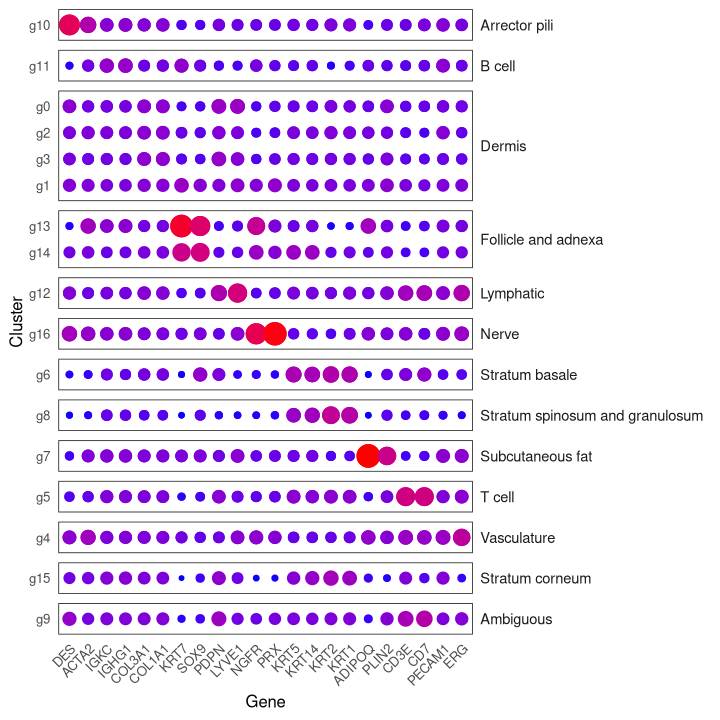

In [522]:
options(repr.plot.width = 6, repr.plot.height = 6)
p <- intermediate_assignment_df %>% group_by(GENE) %>%
    mutate(EXPR = EXPR/sum(EXPR)) %>% 
    left_join(final_assignment_df %>% select(CLUSTER, FINAL_ASSIGNMENT) %>% na.omit()) %>% 
    ungroup() %>% 
    mutate(
        FINAL_ASSIGNMENT = factor(FINAL_ASSIGNMENT, levels=assignment_order),
        CLUSTER = factor(CLUSTER, levels=cluster_order),
        GENE = factor(GENE, levels=gene_order)) %>%
                            
    ggplot(aes(y = CLUSTER, x = GENE)) +
      geom_point(aes(colour=EXPR, size=EXPR)) + 
    scale_size(name = "Mean Expression") +
      scale_color_gradient(low="blue", high="red", name = "Mean Expression") +
        xlab("Gene") +
        ylab("Cluster") +
        theme_bw() +
        theme(panel.grid.major=element_blank(), panel.grid.minor=element_blank(), strip.background = element_blank(), 
              axis.title.x=element_text(size=10), axis.title.y=element_text(size=10),
                 axis.text.x=element_text(size=8, angle = 45, hjust=1, vjust=1),
                axis.ticks.x=element_blank(),
              axis.text.y=element_text(size=8),
                axis.ticks.y=element_blank(),
              strip.text.y = element_text(angle = 0, hjust=0), legend.position="none"
             ) + facet_grid(rows=vars(FINAL_ASSIGNMENT), drop=F, scales="free_y", space="free_y") 
plot(p)

In [523]:
plotFigure(p, file.path(plot_dir, "spatial_dotplot.pdf"), 7, 7)

png 
  2

In [524]:
CLUSTER_COLORS <- colorRampPalette(brewer.pal(12, "Paired"))(length(unique(final_assignment_df$CLUSTER)))
names(CLUSTER_COLORS) <- unique(final_assignment_df$CLUSTER)
FINAL_ASSIGNMENT_COLORS <- colorRampPalette(brewer.pal(12, "Paired"))(length(unique(final_assignment_df$FINAL_ASSIGNMENT)))
names(FINAL_ASSIGNMENT_COLORS) <- unique(final_assignment_df$FINAL_ASSIGNMENT)

In [525]:
object <- immune.combined

projection_df <- data.frame(object@reductions$umap@cell.embeddings) %>%
    mutate(IDENTITY = object@active.ident) %>% mutate(CLUSTER = paste0("g",IDENTITY)) %>% 
    left_join(final_assignment_df)

label_df <- projection_df %>%
    group_by(FINAL_ASSIGNMENT) %>%
    summarize(projection_1 = mean(umap_1), projection_2 = mean(umap_2)) %>% ungroup()

Joining with `by = join_by(CLUSTER)`
Warning message in left_join(., final_assignment_df):
“Detected an unexpected many-to-many relationship between `x` and `y`.
ℹ Row 1 of `x` matches multiple rows in `y`.
ℹ Row 7 of `y` matches multiple rows in `x`.
ℹ If a many-to-many relationship is expected, set `relationship = "many-to-many"` to silence this warning.”


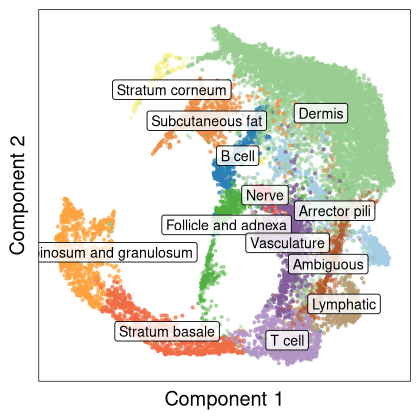

In [526]:
options(repr.plot.width = 3.5, repr.plot.height = 3.5)

p <- ggplot(projection_df, aes(x = umap_1, y = umap_2)) + 
theme_bw() +
theme(legend.position="none", legend.title=element_blank(), axis.title.x=element_text(size=12), axis.title.y=element_text(size=12),
         axis.text.x=element_blank(),
        axis.ticks.x=element_blank(),
      axis.text.y=element_blank(),
        axis.ticks.y=element_blank(),panel.grid.major=element_blank(), panel.grid.minor=element_blank()
     ) +
scale_color_manual(values=FINAL_ASSIGNMENT_COLORS) +
geom_point(size = 0.5, aes(color=FINAL_ASSIGNMENT), alpha = 0.4) +
geom_label(data=label_df, aes(x=projection_1, y=projection_2, label = FINAL_ASSIGNMENT), size = 3, alpha = 0.8) +
xlab("Component 1") +
ylab("Component 2")
plot(p)

In [527]:
plotFigure(p, file.path(plot_dir, "spatial_umap_assignments.pdf"), 5, 5)

png 
  2

In [252]:
object <- immune.combined

projection_df <- data.frame(object@reductions$umap@cell.embeddings) %>%
    mutate(IDENTITY = object@active.ident) %>% mutate(CLUSTER = paste0("g",IDENTITY)) %>% 
    left_join(final_assignment_df)

label_df <- projection_df %>%
    group_by(IDENTITY) %>%
    summarize(projection_1 = mean(umap_1), projection_2 = mean(umap_2)) %>% ungroup()

Joining with `by = join_by(CLUSTER)`


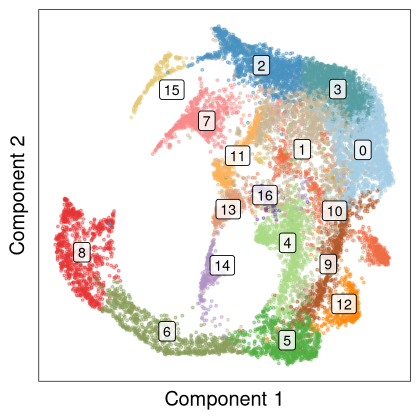

In [253]:
options(repr.plot.width = 3.5, repr.plot.height = 3.5)

p <- ggplot(projection_df, aes(x = umap_1, y = umap_2)) + 
theme_bw() +
theme(legend.position="none", legend.title=element_blank(), axis.title.x=element_text(size=12), axis.title.y=element_text(size=12),
         axis.text.x=element_blank(),
        axis.ticks.x=element_blank(),
      axis.text.y=element_blank(),
        axis.ticks.y=element_blank(),panel.grid.major=element_blank(), panel.grid.minor=element_blank()
     ) +
scale_color_manual(values=CLUSTER_COLORS) +
geom_point(size = 0.5, aes(color=CLUSTER), alpha = 0.4) +
geom_label(data=label_df, aes(x=projection_1, y=projection_2, label = IDENTITY), size = 3, alpha = 0.8) +
xlab("Component 1") +
ylab("Component 2")
plot(p)

In [254]:
plotFigure(p, file.path(plot_dir, "spatial_umap_clusters.pdf"), 5, 5)

png 
  2

# Identify microarchitecture specific GEX changes

8 is S spinosum/granulosum
6 is S basale

0 is dermis fibroblast

7 is eccrine

4 is endothelial

In [619]:
pseudo_immune <- AggregateExpression(immune.combined, assays = "SCT", 
                                   return.seurat = T, group.by = c("DISEASE", "PATIENT", "seurat_clusters"))

# Creates Ident e.g. DLE_DLE1_0

### epidermis

In [320]:
pseudo_immune_subset <- subset(pseudo_immune, seurat_clusters == "8")

In [321]:
pca_obj <- pseudo_immune_subset@assays$SCT$data %>%
    prcomp()

In [322]:
variance <- data.frame(variance = pca_obj$sdev^2 / sum(pca_obj$sdev^2)) %>%
    mutate(component = row_number()) %>% filter(component < 6)

In [323]:
pc1_var <- (variance %>% filter(component == 1) %>% select(variance) %>% as.numeric() %>% round(3) *100) %>% as.character()
pc2_var <- (variance %>% filter(component == 2) %>% select(variance) %>% as.numeric() %>% round(3) *100) %>% as.character()

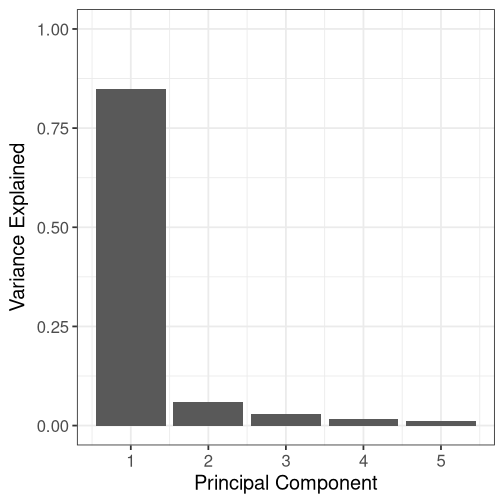

In [324]:
# Scree plot
options(repr.plot.width=4.2, repr.plot.height=4.2)
ggplot(variance, aes(y=variance, x = component)) + 
  geom_col()+
  xlab("Principal Component") + 
  ylab("Variance Explained") +
  theme_bw() +
  ylim(0, 1) +
  theme(axis.title.x=element_text(size=12), axis.text.x=element_text(size=10), axis.title.y=element_text(size=12), axis.text.y=element_text(size=10), strip.text=element_text(size=12), legend.text=element_text(size=10), legend.title=element_text(size=12))

In [325]:
df_out <- pca_obj$rotation %>% data.frame() %>% select(PC1, PC2) %>%
    rownames_to_column("SAMPLE") %>%
    rowwise() %>%
    mutate(STATUS = strsplit(SAMPLE, split = "_")[[1]][1], PATIENT = strsplit(SAMPLE, split = "_")[[1]][2]) 

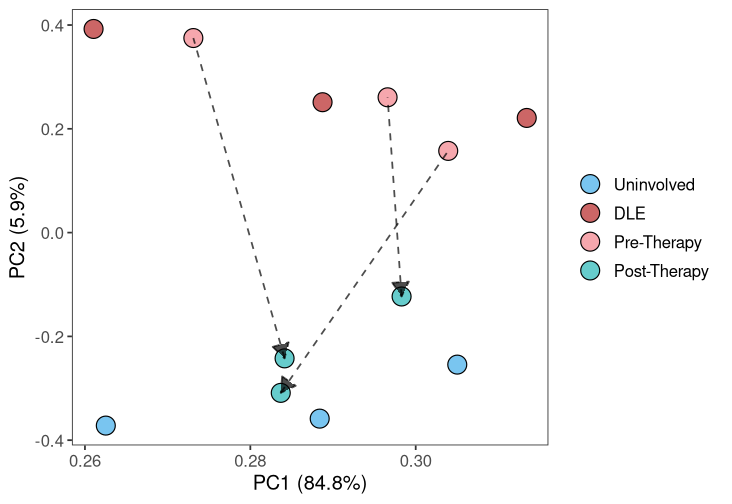

In [326]:
options(repr.plot.width=6.1, repr.plot.height=4.2)

df_out <- df_out %>%
    mutate(DISEASE_FANCY = factor(DISEASE_NAMES[STATUS], levels=DISEASE_ORDER))

p <- ggplot(df_out,aes(x=PC1,y=PC2,fill=DISEASE_FANCY))+
    geom_point(colour="black",pch=21, size=5) +
    geom_path(aes(group=PATIENT), alpha = 0.7, linetype=2, arrow = arrow(ends = "first", type = "closed", length = unit(0.35, "cm"))) +
    scale_fill_manual(values=DISEASE_COLORS) +
    theme_bw() + 
    theme(legend.position="right", axis.title.x=element_text(size=12), axis.text.x=element_text(size=10), axis.title.y=element_text(size=12), axis.text.y=element_text(size=10), 
          strip.text=element_text(size=12), legend.text=element_text(size=10), legend.title=element_blank(), 
          panel.grid.major = element_blank(),
          panel.grid.minor = element_blank()
         ) +
    xlab(paste0("PC1 (", pc1_var, "%)")) +
    ylab(paste0("PC2 (", pc2_var, "%)")) #+
    # scale_fill_manual(values=STATUS_NAIVE_COLORS, name="Status", labels=fancy_status_naive_vector) +
    # scale_color_manual(values=STATUS_NAIVE_COLORS, name="Status", labels=fancy_status_naive_vector)
plot(p)

In [327]:
plotFigure(p, file.path(plot_dir, "epidermis_pca.pdf"), 5.5, 4)

png 
  2

In [328]:
Idents(pseudo_immune_subset) <- "DISEASE"
bulk.de <- pseudo_immune_subset %>% subset((DISEASE == "LE BEFORE" | DISEASE == "LE AFTER")) %>%
    FindMarkers(ident.1 = "LE BEFORE", ident.2 = "LE AFTER", test.use = "DESeq2") %>%
    rownames_to_column("GENE") %>%
    mutate(log10_p_val_adj = -log10(p_val_adj))

# bulk.de <- pseudo_immune_subset %>% subset((DISEASE == "LE BEFORE" | DISEASE == "LE AFTER")) %>%
#     DESeq2FullVersion(status_1 = "LE BEFORE", 
#                       status_2 = "LE AFTER", 
#                       cluster_id = "0", patient_field = "PATIENT") %>%
#     data.frame() %>%
#     rownames_to_column("GENE")  %>%
#                     mutate(log10_p_val_adj = -log10(padj)) %>%
#     rename(avg_log2FC = log2FoldChange) %>% arrange(padj)

head(bulk.de, n = 15)

converting counts to integer mode

gene-wise dispersion estimates

mean-dispersion relationship

final dispersion estimates



,GENE,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,log10_p_val_adj
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,IFI6,1.129220e-49,6.250367,1,1.000,2.039259e-45,44.69053
2,ISG15,1.936206e-35,5.511137,1,1.000,3.496594e-31,30.45635
3,MX1,6.411120e-29,3.987831,1,1.000,1.157784e-24,23.93637
4,TYMP,7.506552e-27,4.195197,1,1.000,1.355608e-22,21.86787
5,OAS2,2.249767e-25,3.456292,1,1.000,4.062855e-21,20.39117
6,SAMD9,3.167448e-25,3.187402,1,1.000,5.720094e-21,20.24260
7,S100A9,1.131850e-23,6.730622,1,1.000,2.044009e-19,18.68952
8,KRT6C,4.061097e-23,6.111421,1,0.667,7.333935e-19,18.13466
9,HERC6,5.727063e-23,3.137920,1,1.000,1.034250e-18,17.98537


<ScaleContinuousPosition>
 Range:  
 Limits:  -10 --   10

Warning message:
“Removed 16 rows containing missing values or values outside the scale range
(`geom_point()`).”
Warning message:
“ggrepel: 5 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


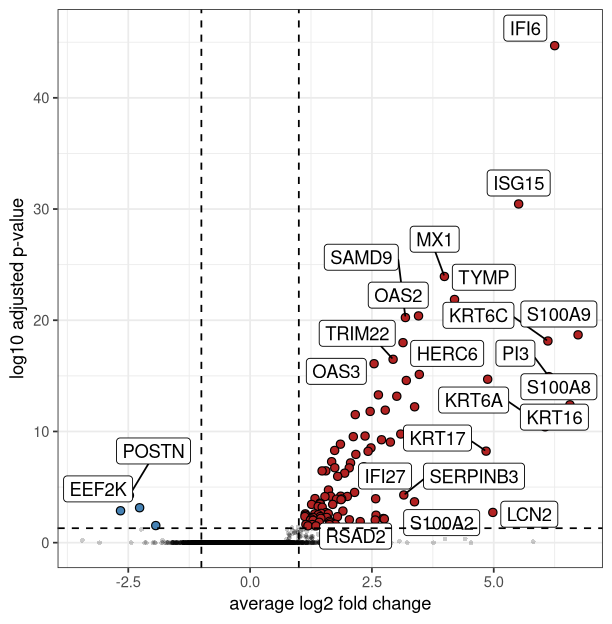

In [329]:
up_genes <- bulk.de %>%
    filter(avg_log2FC > log2(2), log10_p_val_adj > -log10(0.05))
down_genes <- bulk.de %>%
    filter(avg_log2FC < log2(0.5), log10_p_val_adj > -log10(0.05))
sig_genes <-bulk.de %>%
    filter(avg_log2FC < log2(0.2) | avg_log2FC > log2(5), log10_p_val_adj > -log10(0.005))

options(repr.plot.width=5.1, repr.plot.height=5.2)
p <- ggplot(data = bulk.de,
       aes(x = avg_log2FC,
           y = log10_p_val_adj)) + 
  theme_bw() +
  theme(legend.position="none") +
  geom_point(
             alpha = 0.2, 
             shape = 16,
             size = 1) + 
  geom_point(data = up_genes,
             shape = 21,
             size = 2, 
             fill = "firebrick", 
             colour = "black") + 
  geom_point(data = down_genes,
             shape = 21,
             size = 2, 
             fill = "steelblue", 
             colour = "black") + 
  geom_label_repel(data = sig_genes,     
                   aes(label = GENE),
                   force = 2,
                   nudge_y = 1) + 
  xlab("average log2 fold change") + ylab("log10 adjusted p-value") +
  geom_hline(yintercept = -log10(0.05),
             linetype = "dashed") + 
  geom_vline(xintercept = c(log2(0.5), log2(2)),
             linetype = "dashed") 
  scale_x_continuous(breaks = c(seq(-10, 10, 2)),     
                     limits = c(-10, 10)) 	 
plot(p)

In [330]:
plotFigure(p, file.path(plot_dir, "epidermis_volcano.pdf"), 4, 4)

Warning message:
“Removed 16 rows containing missing values or values outside the scale range
(`geom_point()`).”
Warning message:
“ggrepel: 19 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


png 
  2

In [331]:
bulk.spinosum.de <- bulk.de

### dermis

In [620]:
pseudo_immune_subset <- subset(pseudo_immune, seurat_clusters == "0")

In [621]:
pca_obj <- pseudo_immune_subset@assays$SCT$data %>%
    prcomp()

In [622]:
variance <- data.frame(variance = pca_obj$sdev^2 / sum(pca_obj$sdev^2)) %>%
    mutate(component = row_number()) %>% filter(component < 6)

In [623]:
pc1_var <- (variance %>% filter(component == 1) %>% select(variance) %>% as.numeric() %>% round(3) *100) %>% as.character()
pc2_var <- (variance %>% filter(component == 2) %>% select(variance) %>% as.numeric() %>% round(3) *100) %>% as.character()

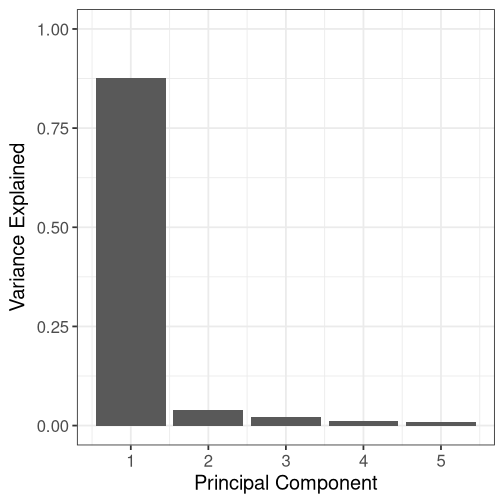

In [624]:
# Scree plot
options(repr.plot.width=4.2, repr.plot.height=4.2)
ggplot(variance, aes(y=variance, x = component)) + 
  geom_col()+
  xlab("Principal Component") + 
  ylab("Variance Explained") +
  theme_bw() +
  ylim(0, 1) +
  theme(axis.title.x=element_text(size=12), axis.text.x=element_text(size=10), axis.title.y=element_text(size=12), axis.text.y=element_text(size=10), strip.text=element_text(size=12), legend.text=element_text(size=10), legend.title=element_text(size=12))

In [625]:
df_out <- pca_obj$rotation %>% data.frame() %>% select(PC1, PC2) %>%
    rownames_to_column("SAMPLE") %>%
    rowwise() %>%
    mutate(STATUS = strsplit(SAMPLE, split = "_")[[1]][1], PATIENT = strsplit(SAMPLE, split = "_")[[1]][2]) 

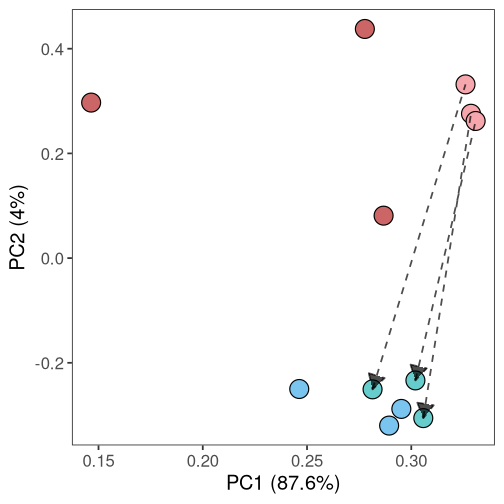

In [626]:
options(repr.plot.width=4.2, repr.plot.height=4.2)

df_out <- df_out %>%
    mutate(DISEASE_FANCY = factor(DISEASE_NAMES[STATUS], levels=DISEASE_ORDER))

p <- ggplot(df_out,aes(x=PC1,y=PC2,fill=DISEASE_FANCY))+
    geom_point(colour="black",pch=21, size=5) +
    geom_path(aes(group=PATIENT), alpha = 0.7, linetype=2, arrow = arrow(ends = "first", type = "closed", length = unit(0.35, "cm"))) +
    scale_fill_manual(values=DISEASE_COLORS) +
    theme_bw() + 
    theme(legend.position="none", axis.title.x=element_text(size=12), axis.text.x=element_text(size=10), axis.title.y=element_text(size=12), axis.text.y=element_text(size=10), 
          strip.text=element_text(size=12), legend.text=element_text(size=10), legend.title=element_blank(), 
          panel.grid.major = element_blank(),
          panel.grid.minor = element_blank()
         ) +
    xlab(paste0("PC1 (", pc1_var, "%)")) +
    ylab(paste0("PC2 (", pc2_var, "%)")) #+
    # scale_fill_manual(values=STATUS_NAIVE_COLORS, name="Status", labels=fancy_status_naive_vector) +
    # scale_color_manual(values=STATUS_NAIVE_COLORS, name="Status", labels=fancy_status_naive_vector)
plot(p)

In [312]:
plotFigure(p, file.path(plot_dir, "dermis_pca.pdf"), 4, 4)

png 
  2

In [313]:
Idents(pseudo_immune_subset) <- "DISEASE"
bulk.de <- pseudo_immune_subset %>% subset((DISEASE == "LE BEFORE" | DISEASE == "LE AFTER")) %>%
    FindMarkers(ident.1 = "LE BEFORE", ident.2 = "LE AFTER", test.use = "DESeq2") %>%
    rownames_to_column("GENE") %>%
    mutate(log10_p_val_adj = -log10(p_val_adj))

# bulk.de <- pseudo_immune_subset %>% subset((DISEASE == "LE BEFORE" | DISEASE == "LE AFTER")) %>%
#     DESeq2FullVersion(status_1 = "LE BEFORE", 
#                       status_2 = "LE AFTER", 
#                       cluster_id = "0", patient_field = "PATIENT") %>%
#     data.frame() %>%
#     rownames_to_column("GENE")  %>%
#                     mutate(log10_p_val_adj = -log10(padj)) %>%
#     rename(avg_log2FC = log2FoldChange) %>% arrange(padj)

head(bulk.de, n = 15)

converting counts to integer mode

gene-wise dispersion estimates

mean-dispersion relationship

final dispersion estimates



,GENE,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,log10_p_val_adj
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,ISG15,7.137109e-62,5.638424,1,1.000,1.288890e-57,56.88978
2,RSAD2,8.198286e-50,4.544170,1,1.000,1.480528e-45,44.82958
3,OAS3,9.473432e-46,3.879080,1,1.000,1.710807e-41,40.76680
4,IFI6,4.767645e-43,5.109766,1,1.000,8.609891e-39,38.06500
5,MX1,8.040745e-38,4.240901,1,1.000,1.452078e-33,32.83801
6,IFIT3,3.783748e-37,4.033760,1,1.000,6.833070e-33,32.16538
7,OAS2,8.912429e-36,3.604676,1,1.000,1.609496e-31,30.79331
8,CMPK2,4.756933e-33,3.591526,1,1.000,8.590545e-29,28.06598
9,ISG20,5.672076e-33,2.891212,1,1.000,1.024320e-28,27.98956


<ScaleContinuousPosition>
 Range:  
 Limits:  -10 --   10

Warning message:
“Removed 9 rows containing missing values or values outside the scale range
(`geom_point()`).”
Warning message:
“ggrepel: 26 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


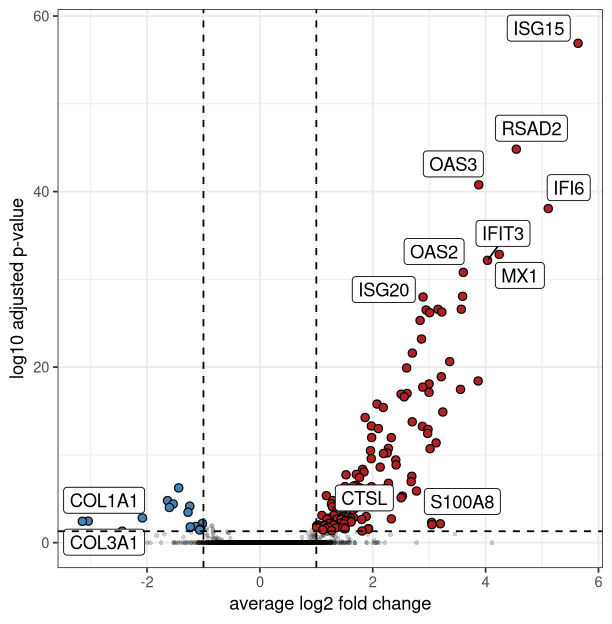

In [314]:
up_genes <- bulk.de %>%
    filter(avg_log2FC > log2(2), log10_p_val_adj > -log10(0.05))
down_genes <- bulk.de %>%
    filter(avg_log2FC < log2(0.5), log10_p_val_adj > -log10(0.05))
sig_genes <-bulk.de %>%
    filter(avg_log2FC < log2(0.2) | avg_log2FC > log2(5), log10_p_val_adj > -log10(0.005))

options(repr.plot.width=5.1, repr.plot.height=5.2)
p <- ggplot(data = bulk.de,
       aes(x = avg_log2FC,
           y = log10_p_val_adj)) + 
  theme_bw() +
  theme(legend.position="none") +
  geom_point(
             alpha = 0.2, 
             shape = 16,
             size = 1) + 
  geom_point(data = up_genes,
             shape = 21,
             size = 2, 
             fill = "firebrick", 
             colour = "black") + 
  geom_point(data = down_genes,
             shape = 21,
             size = 2, 
             fill = "steelblue", 
             colour = "black") + 
  geom_label_repel(data = sig_genes,     
                   aes(label = GENE),
                   force = 2,
                   nudge_y = 1) +
  xlab("average log2 fold change") + ylab("log10 adjusted p-value") +
  geom_hline(yintercept = -log10(0.05),
             linetype = "dashed") + 
  geom_vline(xintercept = c(log2(0.5), log2(2)),
             linetype = "dashed") 
  scale_x_continuous(breaks = c(seq(-10, 10, 2)),     
                     limits = c(-10, 10)) 	 
plot(p)

In [315]:
plotFigure(p, file.path(plot_dir, "dermis_volcano.pdf"), 4, 4)

Warning message:
“Removed 9 rows containing missing values or values outside the scale range
(`geom_point()`).”
Warning message:
“ggrepel: 39 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


png 
  2

In [316]:
bulk.dermis.de <- bulk.de

### adnexa

In [492]:
pseudo_immune_subset <- subset(pseudo_immune, seurat_clusters == "7")

In [493]:
pca_obj <- pseudo_immune_subset@assays$SCT$data %>%
    prcomp()

In [494]:
variance <- data.frame(variance = pca_obj$sdev^2 / sum(pca_obj$sdev^2)) %>%
    mutate(component = row_number()) %>% filter(component < 6)

In [495]:
pc1_var <- (variance %>% filter(component == 1) %>% select(variance) %>% as.numeric() %>% round(3) *100) %>% as.character()
pc2_var <- (variance %>% filter(component == 2) %>% select(variance) %>% as.numeric() %>% round(3) *100) %>% as.character()

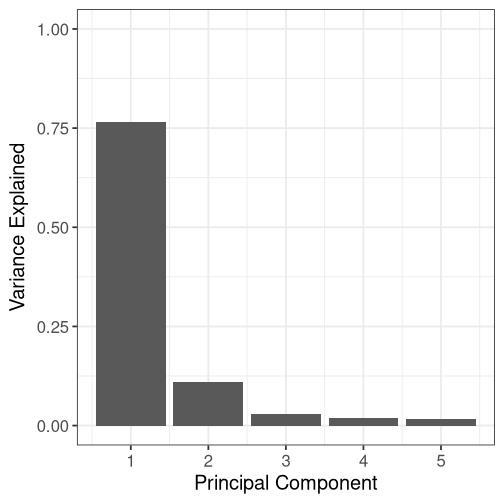

In [496]:
# Scree plot
options(repr.plot.width=4.2, repr.plot.height=4.2)
ggplot(variance, aes(y=variance, x = component)) + 
  geom_col()+
  xlab("Principal Component") + 
  ylab("Variance Explained") +
  theme_bw() +
  ylim(0, 1) +
  theme(axis.title.x=element_text(size=12), axis.text.x=element_text(size=10), axis.title.y=element_text(size=12), axis.text.y=element_text(size=10), strip.text=element_text(size=12), legend.text=element_text(size=10), legend.title=element_text(size=12))

In [497]:
df_out <- pca_obj$rotation %>% data.frame() %>% select(PC1, PC2) %>%
    rownames_to_column("SAMPLE") %>%
    rowwise() %>%
    mutate(STATUS = strsplit(SAMPLE, split = "_")[[1]][1], PATIENT = strsplit(SAMPLE, split = "_")[[1]][2]) 

In [498]:
df_out

SAMPLE,PC1,PC2,STATUS,PATIENT
<chr>,<dbl>,<dbl>,<chr>,<chr>
DLE_DLE1_7,0.2816380,0.33958391,DLE,DLE1
DLE_DLE2_7,0.2520101,0.09747041,DLE,DLE2
DLE_DLE3_7,0.2658171,-0.20774143,DLE,DLE3
HEALTHY_HC1_7,0.2870138,0.22632781,HEALTHY,HC1
HEALTHY_HC2_7,0.2607333,0.62345977,HEALTHY,HC2
HEALTHY_HC3_7,0.2648987,-0.16451897,HEALTHY,HC3
LE AFTER_X1_7,0.2963823,-0.26514084,LE AFTER,X1
LE AFTER_X2_7,0.3216600,-0.18764326,LE AFTER,X2
LE AFTER_X3_7,0.2927228,-0.22625379,LE AFTER,X3


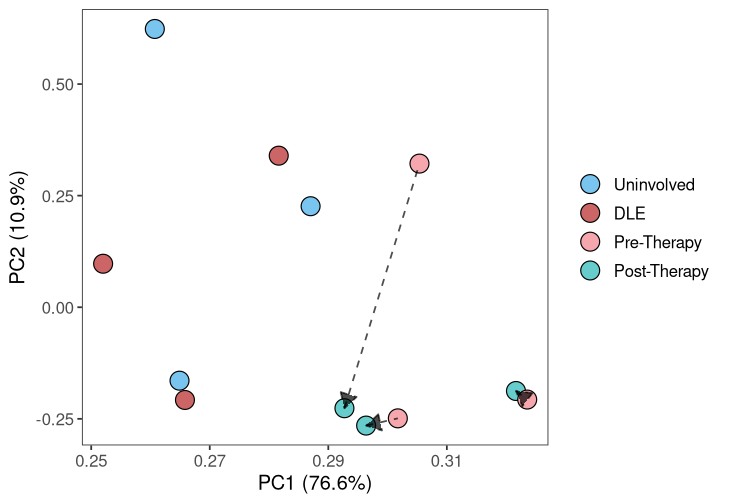

In [499]:
options(repr.plot.width=6.1, repr.plot.height=4.2)

df_out <- df_out %>%
    mutate(DISEASE_FANCY = factor(DISEASE_NAMES[STATUS], levels=DISEASE_ORDER))

p <- ggplot(df_out,aes(x=PC1,y=PC2,fill=DISEASE_FANCY))+
    geom_point(colour="black",pch=21, size=5) +
    geom_path(aes(group=PATIENT), alpha = 0.7, linetype=2, arrow = arrow(ends = "first", type = "closed", length = unit(0.35, "cm"))) +
    scale_fill_manual(values=DISEASE_COLORS) +
    theme_bw() + 
    theme(legend.position="right", axis.title.x=element_text(size=12), axis.text.x=element_text(size=10), axis.title.y=element_text(size=12), axis.text.y=element_text(size=10), 
          strip.text=element_text(size=12), legend.text=element_text(size=10), legend.title=element_blank(), 
          panel.grid.major = element_blank(),
          panel.grid.minor = element_blank()
         ) +
    xlab(paste0("PC1 (", pc1_var, "%)")) +
    ylab(paste0("PC2 (", pc2_var, "%)")) #+
    # scale_fill_manual(values=STATUS_NAIVE_COLORS, name="Status", labels=fancy_status_naive_vector) +
    # scale_color_manual(values=STATUS_NAIVE_COLORS, name="Status", labels=fancy_status_naive_vector)
plot(p)

In [436]:
Idents(pseudo_immune_subset) <- "DISEASE"
bulk.de <- pseudo_immune_subset %>% subset((DISEASE == "LE BEFORE" | DISEASE == "LE AFTER")) %>%
    FindMarkers(ident.1 = "LE BEFORE", ident.2 = "LE AFTER", test.use = "DESeq2") %>%
    rownames_to_column("GENE") %>%
    mutate(log10_p_val_adj = -log10(p_val_adj))

# bulk.de <- pseudo_immune_subset %>% subset((DISEASE == "LE BEFORE" | DISEASE == "LE AFTER")) %>%
#     DESeq2FullVersion(status_1 = "LE BEFORE", 
#                       status_2 = "LE AFTER", 
#                       cluster_id = "0", patient_field = "PATIENT") %>%
#     data.frame() %>%
#     rownames_to_column("GENE")  %>%
#                     mutate(log10_p_val_adj = -log10(padj)) %>%
#     rename(avg_log2FC = log2FoldChange) %>% arrange(padj)

head(bulk.de, n = 15)

converting counts to integer mode

gene-wise dispersion estimates

mean-dispersion relationship

final dispersion estimates



,GENE,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,log10_p_val_adj
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,ISG15,1.437261e-32,4.967202,1,1.000,2.595550e-28,27.585771
2,IFI6,1.045674e-26,5.118732,1,1.000,1.888383e-22,21.723910
3,IFIT1,1.228843e-20,3.721554,1,1.000,2.219168e-16,15.653810
4,HERC6,2.530691e-19,3.686071,1,1.000,4.570175e-15,14.340067
5,MX1,6.932750e-19,4.098647,1,1.000,1.251985e-14,13.902401
6,OAS2,1.630776e-18,3.538840,1,1.000,2.945018e-14,13.530912
7,IFIT3,2.217758e-18,3.748678,1,1.000,4.005049e-14,13.397392
8,OAS3,4.157730e-18,3.485566,1,1.000,7.508446e-14,13.124450
9,OAS1,9.138328e-16,3.353618,1,1.000,1.650291e-11,10.782440


<ScaleContinuousPosition>
 Range:  
 Limits:  -10 --   10

Warning message:
“Removed 92 rows containing missing values or values outside the scale range
(`geom_point()`).”
Warning message:
“ggrepel: 19 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


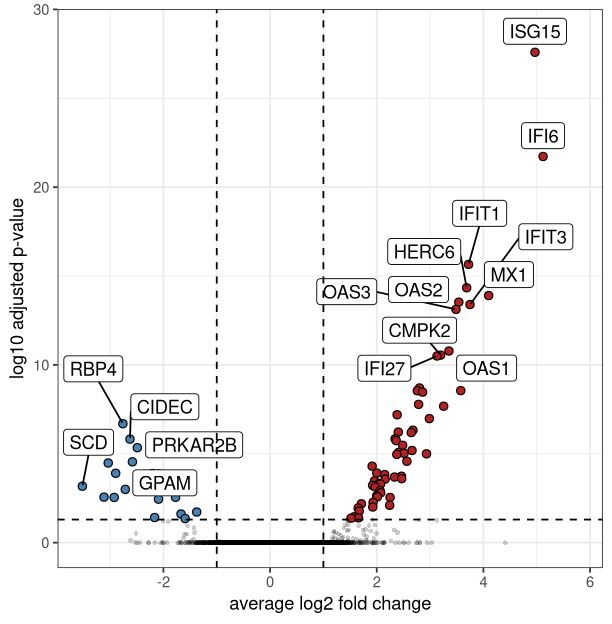

In [437]:
up_genes <- bulk.de %>%
    filter(avg_log2FC > log2(2), log10_p_val_adj > -log10(0.05))
down_genes <- bulk.de %>%
    filter(avg_log2FC < log2(0.5), log10_p_val_adj > -log10(0.05))
sig_genes <-bulk.de %>%
    filter(avg_log2FC < log2(0.2) | avg_log2FC > log2(5), log10_p_val_adj > -log10(0.005))

options(repr.plot.width=5.1, repr.plot.height=5.2)
p <- ggplot(data = bulk.de,
       aes(x = avg_log2FC,
           y = log10_p_val_adj)) + 
  theme_bw() +
  theme(legend.position="none") +
  geom_point(
             alpha = 0.2, 
             shape = 16,
             size = 1) + 
  geom_point(data = up_genes,
             shape = 21,
             size = 2, 
             fill = "firebrick", 
             colour = "black") + 
  geom_point(data = down_genes,
             shape = 21,
             size = 2, 
             fill = "steelblue", 
             colour = "black") + 
  geom_label_repel(data = sig_genes,     
                   aes(label = GENE),
                   force = 2,
                   nudge_y = 1) +
  xlab("average log2 fold change") + ylab("log10 adjusted p-value") +
  geom_hline(yintercept = -log10(0.05),
             linetype = "dashed") + 
  geom_vline(xintercept = c(log2(0.5), log2(2)),
             linetype = "dashed") 
  scale_x_continuous(breaks = c(seq(-10, 10, 2)),     
                     limits = c(-10, 10)) 	 
plot(p)

In [438]:
bulk.adnexa.de <- bulk.de

### vessels

In [627]:
pseudo_immune_subset <- subset(pseudo_immune, seurat_clusters == "4")

In [628]:
pca_obj <- pseudo_immune_subset@assays$SCT$data %>%
    prcomp()

In [629]:
variance <- data.frame(variance = pca_obj$sdev^2 / sum(pca_obj$sdev^2)) %>%
    mutate(component = row_number()) %>% filter(component < 6)

In [630]:
pc1_var <- (variance %>% filter(component == 1) %>% select(variance) %>% as.numeric() %>% round(3) *100) %>% as.character()
pc2_var <- (variance %>% filter(component == 2) %>% select(variance) %>% as.numeric() %>% round(3) *100) %>% as.character()

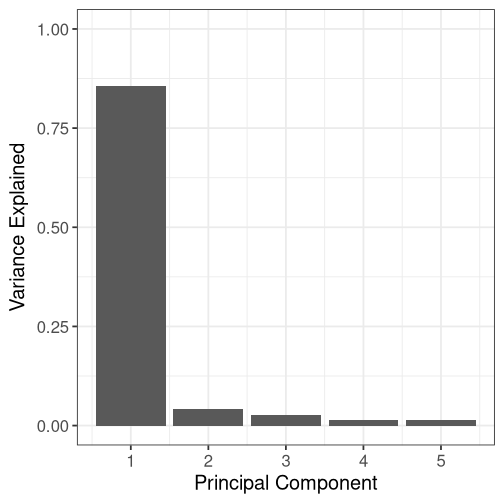

In [631]:
# Scree plot
options(repr.plot.width=4.2, repr.plot.height=4.2)
ggplot(variance, aes(y=variance, x = component)) + 
  geom_col()+
  xlab("Principal Component") + 
  ylab("Variance Explained") +
  theme_bw() +
  ylim(0, 1) +
  theme(axis.title.x=element_text(size=12), axis.text.x=element_text(size=10), axis.title.y=element_text(size=12), axis.text.y=element_text(size=10), strip.text=element_text(size=12), legend.text=element_text(size=10), legend.title=element_text(size=12))

In [632]:
df_out <- pca_obj$rotation %>% data.frame() %>% select(PC1, PC2) %>%
    rownames_to_column("SAMPLE") %>%
    rowwise() %>%
    mutate(STATUS = strsplit(SAMPLE, split = "_")[[1]][1], PATIENT = strsplit(SAMPLE, split = "_")[[1]][2]) 

In [633]:
df_out

SAMPLE,PC1,PC2,STATUS,PATIENT
<chr>,<dbl>,<dbl>,<chr>,<chr>
DLE_DLE1_4,0.2584420,-0.38941925,DLE,DLE1
DLE_DLE2_4,0.1925644,-0.57960954,DLE,DLE2
DLE_DLE3_4,0.2666803,-0.14206896,DLE,DLE3
HEALTHY_HC1_4,0.2612961,0.13032843,HEALTHY,HC1
HEALTHY_HC2_4,0.2796607,0.16888768,HEALTHY,HC2
HEALTHY_HC3_4,0.2905088,0.35076552,HEALTHY,HC3
LE AFTER_X1_4,0.3169793,0.30163790,LE AFTER,X1
LE AFTER_X2_4,0.3049295,0.20444915,LE AFTER,X2
LE AFTER_X3_4,0.2901267,0.24081976,LE AFTER,X3


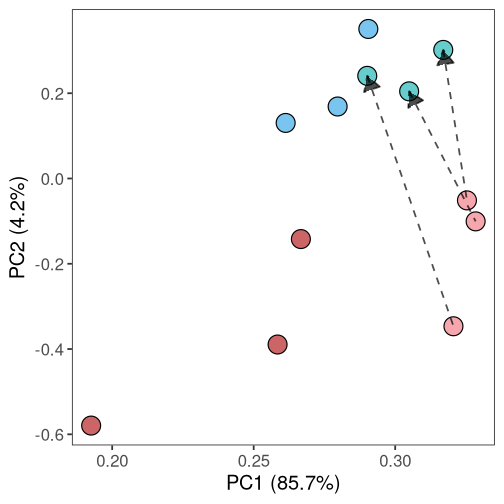

In [634]:
options(repr.plot.width=4.2, repr.plot.height=4.2)

df_out <- df_out %>%
    mutate(DISEASE_FANCY = factor(DISEASE_NAMES[STATUS], levels=DISEASE_ORDER))

p <- ggplot(df_out,aes(x=PC1,y=PC2,fill=DISEASE_FANCY))+
    geom_point(colour="black",pch=21, size=5) +
    geom_path(aes(group=PATIENT), alpha = 0.7, linetype=2, arrow = arrow(ends = "first", type = "closed", length = unit(0.35, "cm"))) +
    scale_fill_manual(values=DISEASE_COLORS) +
    theme_bw() + 
    theme(legend.position="none", axis.title.x=element_text(size=12), axis.text.x=element_text(size=10), axis.title.y=element_text(size=12), axis.text.y=element_text(size=10), 
          strip.text=element_text(size=12), legend.text=element_text(size=10), legend.title=element_blank(), 
          panel.grid.major = element_blank(),
          panel.grid.minor = element_blank()
         ) +
    xlab(paste0("PC1 (", pc1_var, "%)")) +
    ylab(paste0("PC2 (", pc2_var, "%)")) #+
    # scale_fill_manual(values=STATUS_NAIVE_COLORS, name="Status", labels=fancy_status_naive_vector) +
    # scale_color_manual(values=STATUS_NAIVE_COLORS, name="Status", labels=fancy_status_naive_vector)
plot(p)

In [635]:
plotFigure(p, file.path(plot_dir, "vessels_pca.pdf"), 4, 4)

png 
  2

In [290]:
Idents(pseudo_immune_subset) <- "DISEASE"
bulk.de <- pseudo_immune_subset %>% subset((DISEASE == "LE BEFORE" | DISEASE == "LE AFTER")) %>%
    FindMarkers(ident.1 = "LE BEFORE", ident.2 = "LE AFTER", test.use = "DESeq2") %>%
    rownames_to_column("GENE") %>%
    mutate(log10_p_val_adj = -log10(p_val_adj))

# bulk.de <- pseudo_immune_subset %>% subset((DISEASE == "LE BEFORE" | DISEASE == "LE AFTER")) %>%
#     DESeq2FullVersion(status_1 = "LE BEFORE", 
#                       status_2 = "LE AFTER", 
#                       cluster_id = "0", patient_field = "PATIENT") %>%
#     data.frame() %>%
#     rownames_to_column("GENE")  %>%
#                     mutate(log10_p_val_adj = -log10(padj)) %>%
#     rename(avg_log2FC = log2FoldChange) %>% arrange(padj)

head(bulk.de, n = 15)

converting counts to integer mode

gene-wise dispersion estimates

mean-dispersion relationship

final dispersion estimates



,GENE,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,log10_p_val_adj
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,ISG15,3.021206e-41,4.729630,1,1.000,5.455995e-37,36.26313
2,IFI6,2.757553e-38,4.517220,1,1.000,4.979866e-34,33.30278
3,CXCL11,7.942874e-37,4.185290,1,0.667,1.434404e-32,31.84333
4,OAS3,8.063561e-37,3.202539,1,1.000,1.456199e-32,31.83678
5,IFIT3,1.818557e-35,3.744139,1,1.000,3.284133e-31,30.48358
6,IFIT1,9.603116e-35,3.363040,1,1.000,1.734227e-30,29.76089
7,OAS1,1.062868e-31,3.235444,1,1.000,1.919434e-27,26.71683
8,MX1,3.223189e-30,3.517730,1,1.000,5.820757e-26,25.23502
9,RSAD2,8.968047e-28,3.458625,1,1.000,1.619540e-23,22.79061


<ScaleContinuousPosition>
 Range:  
 Limits:  -10 --   10

Warning message:
“Removed 6 rows containing missing values or values outside the scale range
(`geom_point()`).”
Warning message:
“ggrepel: 12 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


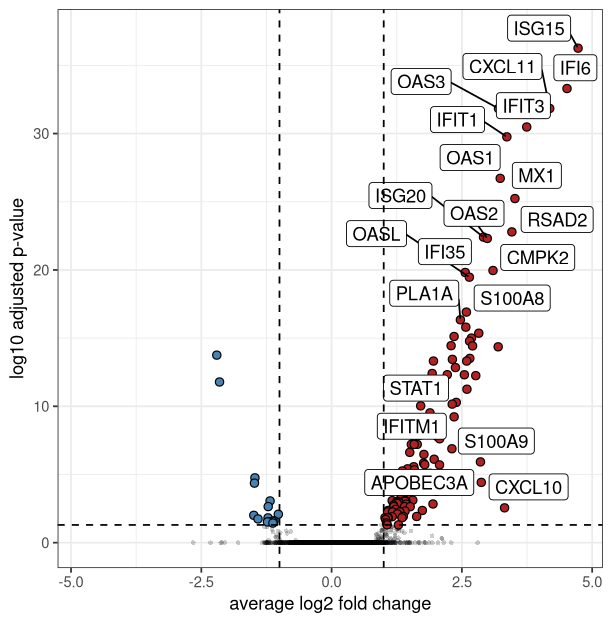

In [291]:
up_genes <- bulk.de %>%
    filter(avg_log2FC > log2(2), log10_p_val_adj > -log10(0.05))
down_genes <- bulk.de %>%
    filter(avg_log2FC < log2(0.5), log10_p_val_adj > -log10(0.05))
sig_genes <-bulk.de %>%
    filter(avg_log2FC < log2(0.2) | avg_log2FC > log2(5), log10_p_val_adj > -log10(0.005))

options(repr.plot.width=5.1, repr.plot.height=5.2)
p <- ggplot(data = bulk.de,
       aes(x = avg_log2FC,
           y = log10_p_val_adj)) + 
  theme_bw() +
  theme(legend.position="none") +
  geom_point(
             alpha = 0.2, 
             shape = 16,
             size = 1) + 
  geom_point(data = up_genes,
             shape = 21,
             size = 2, 
             fill = "firebrick", 
             colour = "black") + 
  geom_point(data = down_genes,
             shape = 21,
             size = 2, 
             fill = "steelblue", 
             colour = "black") + 
  geom_label_repel(data = sig_genes,     
                   aes(label = GENE),
                   force = 2,
                   nudge_y = 1) +
  xlab("average log2 fold change") + ylab("log10 adjusted p-value") +
  geom_hline(yintercept = -log10(0.05),
             linetype = "dashed") + 
  geom_vline(xintercept = c(log2(0.5), log2(2)),
             linetype = "dashed") 
  scale_x_continuous(breaks = c(seq(-10, 10, 2)),     
                     limits = c(-10, 10)) 	 
plot(p)

In [292]:
plotFigure(p, file.path(plot_dir, "vessels_volcano.pdf"), 4, 4)

Warning message:
“Removed 6 rows containing missing values or values outside the scale range
(`geom_point()`).”
Warning message:
“ggrepel: 19 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


png 
  2

In [293]:
bulk.vessel.de <- bulk.de

# Select gene analysis

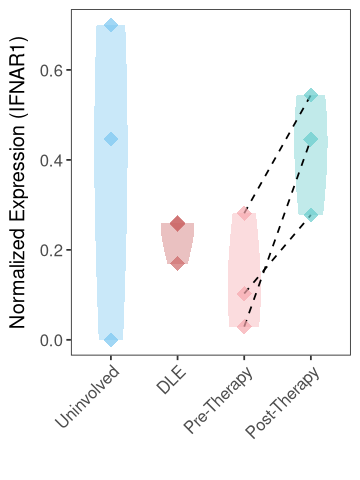

In [354]:
pseudo_immune_subset <- subset(pseudo_immune, seurat_clusters == "8")

expr_tab <- pseudo_immune_subset$SCT$data %>% data.frame() %>%
    rownames_to_column("GENE") %>%
    filter(GENE == "IFNAR1") %>% 
    gather(key="SAMPLE", value = "EXPR", -GENE) %>%
    rowwise() %>%
    mutate(DISEASE = strsplit(SAMPLE, split = "_")[[1]][1], PATIENT = strsplit(SAMPLE, split = "_")[[1]][2])

options(repr.plot.width=3, repr.plot.height=4)

p <- expr_tab  %>%
    mutate(DISEASE_FANCY = factor(DISEASE_NAMES[DISEASE], levels=DISEASE_ORDER)) %>%
    ggplot(aes(x=DISEASE_FANCY, y=EXPR)) +
    scale_fill_manual(values=DISEASE_COLORS) +
    scale_color_manual(values=DISEASE_COLORS) +
    theme_bw() + 
    theme(legend.position="none", axis.title.x=element_text(size=12), 
          axis.text.x=element_text(size=10, angle = 45, hjust = 1, vjust = 1), 
          axis.title.y=element_text(size=12), axis.text.y=element_text(size=10), 
          panel.grid.major = element_blank(), panel.grid.minor = element_blank(),
          strip.text=element_text(size=8), legend.text=element_text(size=10), legend.title=element_text(size=12)) +
    xlab("") +
    ylab(expression("Normalized Expression (IFNAR1)")) +
    #scale_y_continuous(expand = expand_scale(mult = c(0.1, 0.5))) +
    geom_violin(aes(fill=DISEASE_FANCY), color=NA, alpha=0.4, scale="width", trim=T, adjust=2, width=0.5) +
    # geom_errorbarh(data=migrant_sum, 
    #                aes(y=MEAN, color=SUBSET, xmin=(..x..) - 0.4, xmax=(..x..) + 0.4),
    #                height=0, size=0.75, position=position_dodge(0.9), alpha=0.9) +
    geom_line(aes(group = PATIENT), linetype = "dashed") +
    geom_point(aes(color=DISEASE_FANCY), position=position_dodge(0.9), size=4, pch=18, alpha=0.7) 
plot(p)

In [355]:
plotFigure(p, file.path(plot_dir, "ifnar1_epidermis.pdf"), 3, 4)

png 
  2

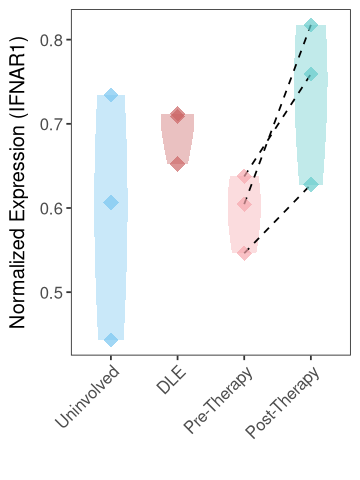

In [356]:
pseudo_immune_subset <- subset(pseudo_immune, seurat_clusters == "4")

expr_tab <- pseudo_immune_subset$SCT$data %>% data.frame() %>%
    rownames_to_column("GENE") %>%
    filter(GENE == "IFNAR1") %>% 
    gather(key="SAMPLE", value = "EXPR", -GENE) %>%
    rowwise() %>%
    mutate(DISEASE = strsplit(SAMPLE, split = "_")[[1]][1], PATIENT = strsplit(SAMPLE, split = "_")[[1]][2])

options(repr.plot.width=3, repr.plot.height=4)

p <- expr_tab  %>%
    mutate(DISEASE_FANCY = factor(DISEASE_NAMES[DISEASE], levels=DISEASE_ORDER)) %>%
    ggplot(aes(x=DISEASE_FANCY, y=EXPR)) +
    scale_fill_manual(values=DISEASE_COLORS) +
    scale_color_manual(values=DISEASE_COLORS) +
    theme_bw() + 
    theme(legend.position="none", axis.title.x=element_text(size=12), 
          axis.text.x=element_text(size=10, angle = 45, hjust = 1, vjust = 1), 
          axis.title.y=element_text(size=12), axis.text.y=element_text(size=10), 
          panel.grid.major = element_blank(), panel.grid.minor = element_blank(),
          strip.text=element_text(size=8), legend.text=element_text(size=10), legend.title=element_text(size=12)) +
    xlab("") +
    ylab(expression("Normalized Expression (IFNAR1)")) +
    #scale_y_continuous(expand = expand_scale(mult = c(0.1, 0.5))) +
    geom_violin(aes(fill=DISEASE_FANCY), color=NA, alpha=0.4, scale="width", trim=T, adjust=2, width=0.5) +
    # geom_errorbarh(data=migrant_sum, 
    #                aes(y=MEAN, color=SUBSET, xmin=(..x..) - 0.4, xmax=(..x..) + 0.4),
    #                height=0, size=0.75, position=position_dodge(0.9), alpha=0.9) +
    geom_line(aes(group = PATIENT), linetype = "dashed") +
    geom_point(aes(color=DISEASE_FANCY), position=position_dodge(0.9), size=4, pch=18, alpha=0.7) 
plot(p)

In [357]:
plotFigure(p, file.path(plot_dir, "ifnar1_vessels.pdf"), 3, 4)

png 
  2

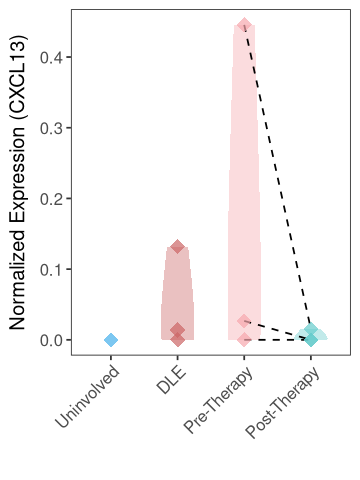

In [366]:
pseudo_immune_subset <- subset(pseudo_immune, seurat_clusters == "8")

expr_tab <- pseudo_immune_subset$SCT$data %>% data.frame() %>%
    rownames_to_column("GENE") %>%
    filter(GENE == "CXCL13") %>% 
    gather(key="SAMPLE", value = "EXPR", -GENE) %>%
    rowwise() %>%
    mutate(DISEASE = strsplit(SAMPLE, split = "_")[[1]][1], PATIENT = strsplit(SAMPLE, split = "_")[[1]][2])

options(repr.plot.width=3, repr.plot.height=4)

p <- expr_tab  %>%
    mutate(DISEASE_FANCY = factor(DISEASE_NAMES[DISEASE], levels=DISEASE_ORDER)) %>%
    ggplot(aes(x=DISEASE_FANCY, y=EXPR)) +
    scale_fill_manual(values=DISEASE_COLORS) +
    scale_color_manual(values=DISEASE_COLORS) +
    theme_bw() + 
    theme(legend.position="none", axis.title.x=element_text(size=12), 
          axis.text.x=element_text(size=10, angle = 45, hjust = 1, vjust = 1), 
          axis.title.y=element_text(size=12), axis.text.y=element_text(size=10), 
          panel.grid.major = element_blank(), panel.grid.minor = element_blank(),
          strip.text=element_text(size=8), legend.text=element_text(size=10), legend.title=element_text(size=12)) +
    xlab("") +
    ylab(expression("Normalized Expression (CXCL13)")) +
    #scale_y_continuous(expand = expand_scale(mult = c(0.1, 0.5))) +
    geom_violin(aes(fill=DISEASE_FANCY), color=NA, alpha=0.4, scale="width", trim=T, adjust=2, width=0.5) +
    # geom_errorbarh(data=migrant_sum, 
    #                aes(y=MEAN, color=SUBSET, xmin=(..x..) - 0.4, xmax=(..x..) + 0.4),
    #                height=0, size=0.75, position=position_dodge(0.9), alpha=0.9) +
    geom_line(aes(group = PATIENT), linetype = "dashed") +
    geom_point(aes(color=DISEASE_FANCY), position=position_dodge(0.9), size=4, pch=18, alpha=0.7) 
plot(p)

In [367]:
plotFigure(p, file.path(plot_dir, "cxcl13_epidermis.pdf"), 3, 4)

png 
  2

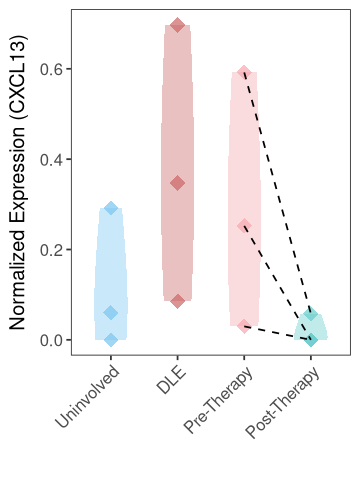

In [368]:
pseudo_immune_subset <- subset(pseudo_immune, seurat_clusters == "4")

expr_tab <- pseudo_immune_subset$SCT$data %>% data.frame() %>%
    rownames_to_column("GENE") %>%
    filter(GENE == "CXCL13") %>% 
    gather(key="SAMPLE", value = "EXPR", -GENE) %>%
    rowwise() %>%
    mutate(DISEASE = strsplit(SAMPLE, split = "_")[[1]][1], PATIENT = strsplit(SAMPLE, split = "_")[[1]][2])

options(repr.plot.width=3, repr.plot.height=4)

p <- expr_tab  %>%
    mutate(DISEASE_FANCY = factor(DISEASE_NAMES[DISEASE], levels=DISEASE_ORDER)) %>%
    ggplot(aes(x=DISEASE_FANCY, y=EXPR)) +
    scale_fill_manual(values=DISEASE_COLORS) +
    scale_color_manual(values=DISEASE_COLORS) +
    theme_bw() + 
    theme(legend.position="none", axis.title.x=element_text(size=12), 
          axis.text.x=element_text(size=10, angle = 45, hjust = 1, vjust = 1), 
          axis.title.y=element_text(size=12), axis.text.y=element_text(size=10), 
          panel.grid.major = element_blank(), panel.grid.minor = element_blank(),
          strip.text=element_text(size=8), legend.text=element_text(size=10), legend.title=element_text(size=12)) +
    xlab("") +
    ylab(expression("Normalized Expression (CXCL13)")) +
    #scale_y_continuous(expand = expand_scale(mult = c(0.1, 0.5))) +
    geom_violin(aes(fill=DISEASE_FANCY), color=NA, alpha=0.4, scale="width", trim=T, adjust=2, width=0.5) +
    geom_point(aes(color=DISEASE_FANCY), position=position_dodge(0.9), size=4, pch=18, alpha=0.7) +
    # geom_errorbarh(data=migrant_sum, 
    #                aes(y=MEAN, color=SUBSET, xmin=(..x..) - 0.4, xmax=(..x..) + 0.4),
    #                height=0, size=0.75, position=position_dodge(0.9), alpha=0.9) +
    geom_line(aes(group = PATIENT), linetype = "dashed")
    
plot(p)

In [369]:
plotFigure(p, file.path(plot_dir, "cxcl13_vessels.pdf"), 3, 4)

png 
  2

In [36]:
bulk.endothelial.de %>%
    tibble::rownames_to_column("gene") %>%
    filter(gene == "CXCL13")

gene,p_val,avg_log2FC,pct.1,pct.2,p_val_adj
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
CXCL13,0.002704425,0.7793954,1,0.333,1


In [35]:
bulk.dermis.de %>%
    tibble::rownames_to_column("gene") %>%
    filter(gene == "CXCL13")

gene,p_val,avg_log2FC,pct.1,pct.2,p_val_adj
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
CXCL13,0.02969472,0.2712504,0.833,0.333,1


In [40]:
bulk.adnexa.de %>%
    tibble::rownames_to_column("gene") %>%
    filter(gene == "CXCL13")

gene,p_val,avg_log2FC,pct.1,pct.2,p_val_adj
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
CXCL13,0.02930724,-0.3275912,0.667,0.333,1


In [41]:
write.csv(bulk.spinosum.de, file.path(output_dir, "spinosum_gex.csv"))

In [42]:
write.csv(bulk.endothelial.de, file.path(output_dir, "endothelial_gex.csv"))

In [43]:
write.csv(bulk.dermis.de, file.path(output_dir, "dermis_gex.csv"))

In [44]:
write.csv(bulk.adnexa.de, file.path(output_dir, "adnexa_gex.csv"))

In [45]:
output_dir

[1] "/home/ruoyi/Dropbox/Projects/Gelhausen_CLE/Spatial/data"

# Gene Ontology

In [332]:
dbs <- c(
"Reactome" = "Reactome_2022",
#"GO" = "GO_Biological_Process_2023",
"BioPlanet"= "BioPlanet_2019"
)
db_reverse <- names(dbs)
names(db_reverse) <- dbs

In [333]:
BOOL_COLORS <- c(
    'TRUE' = '#e33e1a', 
    'FALSE' = '#dfd9d8'
)

Uploading data to Enrichr... Done.
  Querying Reactome_2022... Done.
  Querying BioPlanet_2019... Done.
Parsing results... Done.


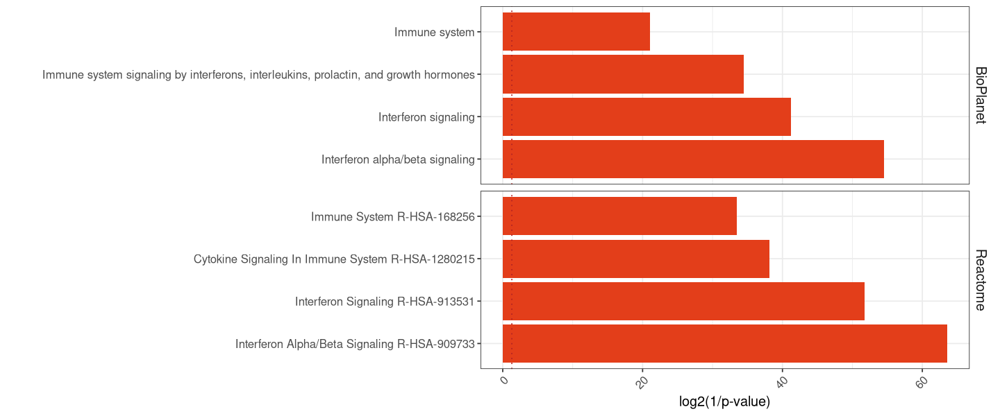

In [334]:
input <- bulk.spinosum.de  %>%
    filter(avg_log2FC > log2(5), log10_p_val_adj > -log10(0.005))

#p_value_thresh_gene <- 0.1
p_value_thresh_go <- 0.05

pos_go <- input %>%
    filter(!grepl("RP[L,S]", GENE), !grepl("A[C,L][0-9]", GENE), !grepl("orf", GENE), !grepl("LINC", GENE)) %>%
    select(GENE) %>% unlist() %>%
    enrichr(databases=dbs) %>%
    bind_rows(.id="GO") %>%
    group_by(GO) %>%
    top_n(n=4, wt=-P.value) %>%
    select(GO, Term, P.value, Adjusted.P.value) %>%
    mutate(LABEL = P.value < p_value_thresh_go, LOG_PVALUE = log(1/P.value))

options(repr.plot.width=12, repr.plot.height=5)
go_order <- pos_go %>% 
    arrange(-LOG_PVALUE) %>% ungroup() %>% select(Term) %>% unlist()

pos_go_term <- pos_go  %>% 
    mutate(Term = factor(Term, levels=go_order)) %>%
    ungroup() %>% mutate(GO = db_reverse[GO])

p <- ggplot(pos_go_term, aes(x=Term, y=LOG_PVALUE, fill = LABEL)) + theme_bw() +
    theme(legend.position="none", 
          axis.title.x=element_text(size=12), axis.text.x=element_text(size=10, angle=45, hjust=1, vjust=1), 
          axis.title.y=element_text(size=12), axis.text.y=element_text(size=10), 
          strip.background = element_blank(),
          strip.text=element_text(size=12),
          legend.text=element_text(size=10), legend.title=element_text(size=12)) +
    geom_bar(stat='identity') +
    xlab("") +
    ylab("log2(1/p-value)") +
    coord_flip() +
    geom_hline(yintercept = log10(1/p_value_thresh_go), color="firebrick", linetype="dotted") +
    scale_fill_manual(values=BOOL_COLORS) +
    facet_grid(GO ~ ., scales="free" )
plot(p)

In [337]:
plotFigure(p, file.path(plot_dir, "ontology.pdf"), 8, 5)

png 
  2

Uploading data to Enrichr... Done.
  Querying Reactome_2022... Done.
  Querying BioPlanet_2019... Done.
Parsing results... Done.


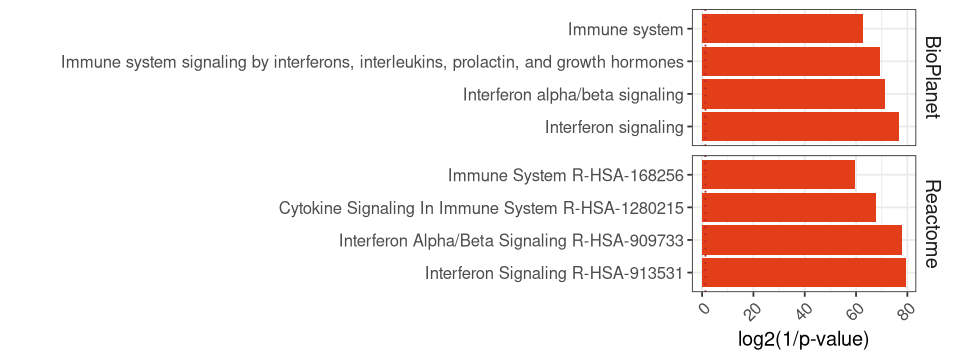

In [458]:
input <- bulk.dermis.de  %>%
    filter(avg_log2FC > log2(5), log10_p_val_adj > -log10(0.005))

#p_value_thresh_gene <- 0.1
p_value_thresh_go <- 0.05

pos_go <- input %>%
    filter(!grepl("RP[L,S]", GENE), !grepl("A[C,L][0-9]", GENE), !grepl("orf", GENE), !grepl("LINC", GENE)) %>%
    select(GENE) %>% unlist() %>%
    enrichr(databases=dbs) %>%
    bind_rows(.id="GO") %>%
    group_by(GO) %>%
    top_n(n=4, wt=-P.value) %>%
    select(GO, Term, P.value, Adjusted.P.value) %>%
    mutate(LABEL = P.value < p_value_thresh_go, LOG_PVALUE = log(1/P.value))

options(repr.plot.width=8, repr.plot.height=3)
go_order <- pos_go %>% 
    arrange(-LOG_PVALUE) %>% ungroup() %>% select(Term) %>% unlist()

pos_go_term <- pos_go  %>% 
    mutate(Term = factor(Term, levels=go_order)) %>%
    ungroup() %>% mutate(GO = db_reverse[GO])

p <- ggplot(pos_go_term, aes(x=Term, y=LOG_PVALUE, fill = LABEL)) + theme_bw() +
    theme(legend.position="none", 
          axis.title.x=element_text(size=12), axis.text.x=element_text(size=10, angle=45, hjust=1, vjust=1), 
          axis.title.y=element_text(size=12), axis.text.y=element_text(size=10), 
          strip.background = element_blank(),
          strip.text=element_text(size=12),
          legend.text=element_text(size=10), legend.title=element_text(size=12)) +geom_bar(stat='identity') +
    xlab("") +
    ylab("log2(1/p-value)") +
    coord_flip() +
    geom_hline(yintercept = log10(1/p_value_thresh_go), color="firebrick", linetype="dotted") +
    scale_fill_manual(values=BOOL_COLORS) +
    facet_grid(GO ~ ., scales="free" )
plot(p)

Uploading data to Enrichr... Done.
  Querying Reactome_2022... Done.
  Querying BioPlanet_2019... Done.
Parsing results... Done.


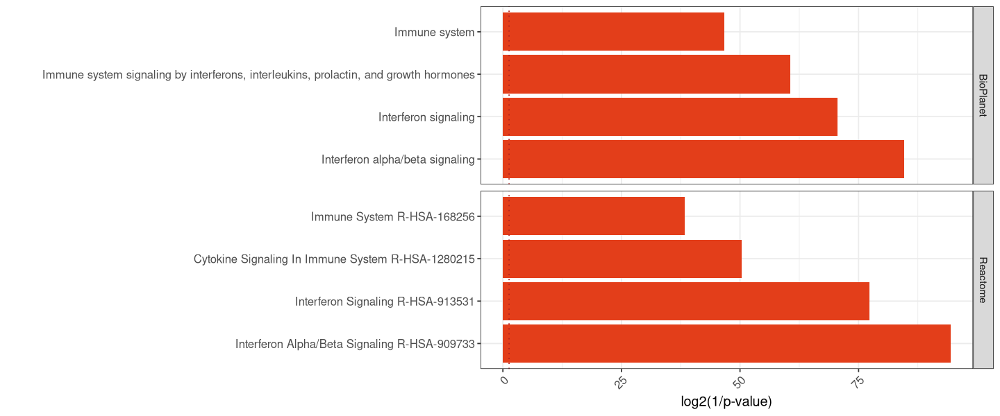

In [454]:
input <- bulk.adnexa.de  %>%
    filter(avg_log2FC > log2(5), log10_p_val_adj > -log10(0.005))

#p_value_thresh_gene <- 0.1
p_value_thresh_go <- 0.05

pos_go <- input %>%
    filter(!grepl("RP[L,S]", GENE), !grepl("A[C,L][0-9]", GENE), !grepl("orf", GENE), !grepl("LINC", GENE)) %>%
    select(GENE) %>% unlist() %>%
    enrichr(databases=dbs) %>%
    bind_rows(.id="GO") %>%
    group_by(GO) %>%
    top_n(n=4, wt=-P.value) %>%
    select(GO, Term, P.value, Adjusted.P.value) %>%
    mutate(LABEL = P.value < p_value_thresh_go, LOG_PVALUE = log(1/P.value))

options(repr.plot.width=12, repr.plot.height=5)
go_order <- pos_go %>% 
    arrange(-LOG_PVALUE) %>% ungroup() %>% select(Term) %>% unlist()

pos_go_term <- pos_go  %>% 
    mutate(Term = factor(Term, levels=go_order)) %>%
    ungroup() %>% mutate(GO = db_reverse[GO])

p <- ggplot(pos_go_term, aes(x=Term, y=LOG_PVALUE, fill = LABEL)) + theme_bw() +
    theme(legend.position="none", axis.title.x=element_text(size=12), axis.text.x=element_text(size=10, angle=45, hjust=1, vjust=1), axis.title.y=element_text(size=12), axis.text.y=element_text(size=10), strip.text=element_text(size=9), legend.text=element_text(size=10), legend.title=element_text(size=12)) +
    geom_bar(stat='identity') +
    xlab("") +
    ylab("log2(1/p-value)") +
    coord_flip() +
    geom_hline(yintercept = log10(1/p_value_thresh_go), color="firebrick", linetype="dotted") +
    scale_fill_manual(values=BOOL_COLORS) +
    facet_grid(GO ~ ., scales="free" )
plot(p)

Uploading data to Enrichr... Done.
  Querying Reactome_2022... Done.
  Querying BioPlanet_2019... Done.
Parsing results... Done.


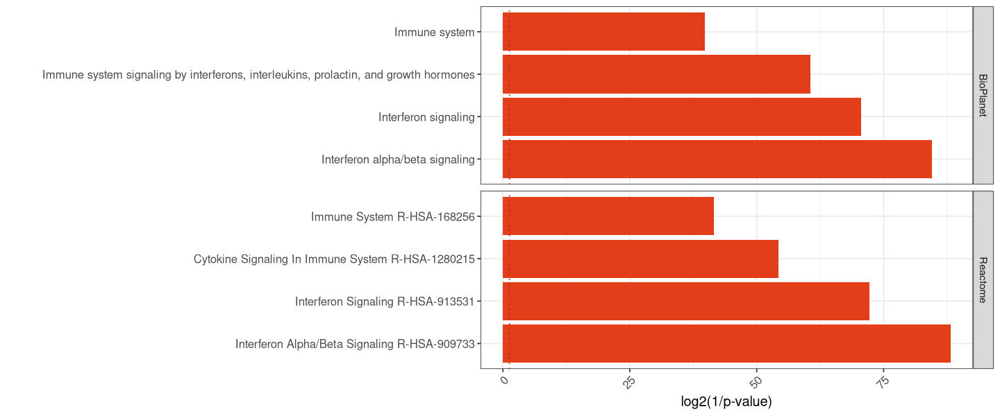

In [455]:
input <- bulk.vessel.de  %>%
    filter(avg_log2FC > log2(5), log10_p_val_adj > -log10(0.005))

#p_value_thresh_gene <- 0.1
p_value_thresh_go <- 0.05

pos_go <- input %>%
    filter(!grepl("RP[L,S]", GENE), !grepl("A[C,L][0-9]", GENE), !grepl("orf", GENE), !grepl("LINC", GENE)) %>%
    select(GENE) %>% unlist() %>%
    enrichr(databases=dbs) %>%
    bind_rows(.id="GO") %>%
    group_by(GO) %>%
    top_n(n=4, wt=-P.value) %>%
    select(GO, Term, P.value, Adjusted.P.value) %>%
    mutate(LABEL = P.value < p_value_thresh_go, LOG_PVALUE = log(1/P.value))

options(repr.plot.width=12, repr.plot.height=5)
go_order <- pos_go %>% 
    arrange(-LOG_PVALUE) %>% ungroup() %>% select(Term) %>% unlist()

pos_go_term <- pos_go  %>% 
    mutate(Term = factor(Term, levels=go_order)) %>%
    ungroup() %>% mutate(GO = db_reverse[GO])

p <- ggplot(pos_go_term, aes(x=Term, y=LOG_PVALUE, fill = LABEL)) + theme_bw() +
    theme(legend.position="none", axis.title.x=element_text(size=12), axis.text.x=element_text(size=10, angle=45, hjust=1, vjust=1), axis.title.y=element_text(size=12), axis.text.y=element_text(size=10), strip.text=element_text(size=9), legend.text=element_text(size=10), legend.title=element_text(size=12)) +
    geom_bar(stat='identity') +
    xlab("") +
    ylab("log2(1/p-value)") +
    coord_flip() +
    geom_hline(yintercept = log10(1/p_value_thresh_go), color="firebrick", linetype="dotted") +
    scale_fill_manual(values=BOOL_COLORS) +
    facet_grid(GO ~ ., scales="free" )
plot(p)

# Integrate with Single Cell
https://github.com/satijalab/seurat/issues/8684

https://github.com/satijalab/seurat/issues/8425

The tutorial is not meant for integrated data, this pipeline had to be pieced together

This may get stuck running. If that happens, restart kernel and just load spatial and run this section. 

In [370]:
# single.combined@assays$SCT@SCTModel.list <- single.combined@assays$SCT@SCTModel.list[1]
#x <- subset(single.combined, SAMPLE == "CLE1")

In [12]:
single.combined <- readRDS(file.path(output_dir, "single.combined.rds"))

In [ ]:
# should only take 2 min to run, ONLY WORKS WITH immune.combined.rds July 6,2024 version
anchors <- FindTransferAnchors(reference = single.combined, query = immune.combined, 
                               dims = 1:30, reference.assay = "integrated", query.assay = "integrated")


Warning message in ValidateParams_FindTransferAnchors(reference = reference, query = query, :
“Both reference and query assays have been processed with SCTransform.Setting normalization.method = 'SCT' and continuing.”
Normalizing query using reference SCT model

Warning message:
“No layers found matching search pattern provided”
Performing PCA on the provided reference using 1910 features as input.

Projecting cell embeddings



In [ ]:
predictions.assay <- TransferData(anchorset = anchors, refdata = single.combined$seurat_clusters, prediction.assay = TRUE, 
                               # weight.reduction = immune.combined[["pca"]],
                                dims = 1:30)

In [ ]:
immune.combined[["predictions"]] <- predictions.assay

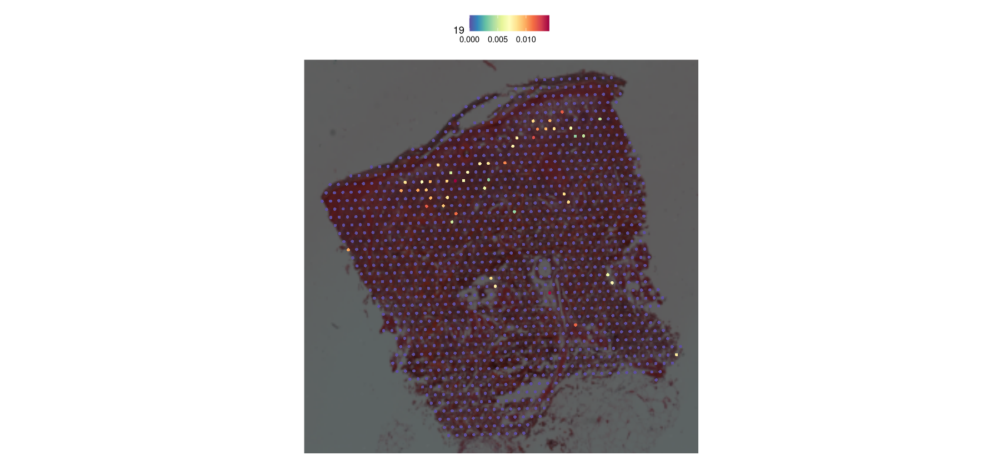

In [15]:
options(repr.plot.width = 15, repr.plot.height = 7)
DefaultAssay(immune.combined) <- "predictions"
SpatialFeaturePlot(immune.combined, features = c("19"), pt.size.factor = 1.6, ncol = 1, crop = TRUE,
                    images = c("SCLE_pre"))

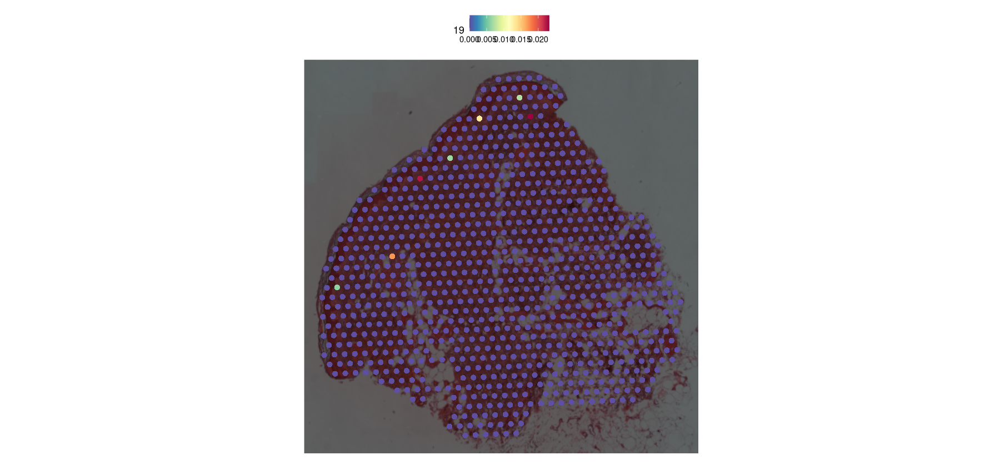

In [16]:
options(repr.plot.width = 15, repr.plot.height = 7)
DefaultAssay(immune.combined) <- "predictions"
SpatialFeaturePlot(immune.combined, features = c("19"), pt.size.factor = 1.6, ncol = 1, crop = TRUE,
                    images = c("SCLE_post"))

In [ ]:
assignment_summary <- immune.combined@assays$predictions$data %>% data.frame() %>%
    rownames_to_column("assignment") %>% 
    gather(cell, value, -assignment) %>%
    rowwise() %>%
    mutate(IDX = strsplit(cell, split = '_')[[1]][2]) %>%
    group_by(assignment, IDX) %>%
    summarize(frequency = mean(value))

In [ ]:
data.frame(SAMPLE = immune.combined@images %>% names(), IDX = as.character(1:12)) -> rename_df

In [17]:
# Fibroblast
subset_tab <- assignment_summary %>%
    filter(assignment %in% c(3,4)) %>% group_by(IDX) %>% summarize(FREQ = sum(frequency)) %>%
    left_join(rename_df) %>%
    left_join(meta_df %>% select(SAMPLE, STATUS, PATIENT, DISEASE)) #%>%
    #filter(DISEASE %in% c("LE BEFORE", "LE AFTER"))
subset_tab

Joining with `by = join_by(IDX)`
Joining with `by = join_by(SAMPLE)`


IDX,FREQ,SAMPLE,STATUS,PATIENT,DISEASE
<chr>,<dbl>,<chr>,<chr>,<chr>,<chr>
1,0.80324512,Ctrl_C1RF,HEALTHY,HC3,HEALTHY
10,0.49482906,X2_pre_IFN_1,LUPUS,X2,LE BEFORE
11,0.83366653,X3_post_IFN_2,LUPUS,X3,LE AFTER
12,0.58375944,X3_pre_IFN_1,LUPUS,X3,LE BEFORE
2,0.58609341,DLE,LUPUS,DLE3,DLE
3,0.14988838,DLE_A,LUPUS,DLE1,DLE
4,0.05316022,DLE_B,LUPUS,DLE2,DLE
5,0.57507232,HC5,HEALTHY,HC1,HEALTHY
6,0.35715160,HCSA,HEALTHY,HC2,HEALTHY


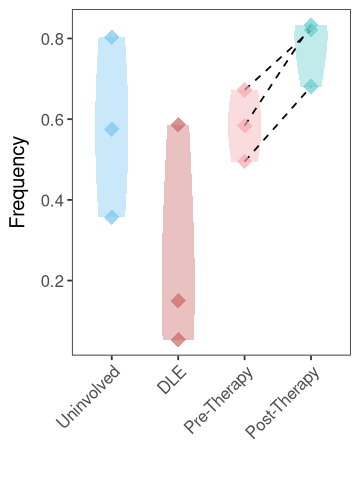

In [18]:
options(repr.plot.width=3, repr.plot.height=4)
p <- subset_tab  %>%
    mutate(DISEASE_FANCY = factor(DISEASE_NAMES[DISEASE], levels=DISEASE_ORDER)) %>%
    ggplot(aes(x=DISEASE_FANCY, y=FREQ)) +
    scale_fill_manual(values=DISEASE_COLORS) +
    scale_color_manual(values=DISEASE_COLORS) +
    theme_bw() + 
    theme(legend.position="none", 
            panel.grid.major=element_blank(), panel.grid.minor=element_blank(),
          axis.title.x=element_text(size=12), axis.text.x=element_text(size=10, angle = 45, hjust = 1, vjust = 1), axis.title.y=element_text(size=12), axis.text.y=element_text(size=10), strip.text=element_text(size=8), legend.text=element_text(size=10), legend.title=element_text(size=12)) +
    xlab("") +
    ylab(expression("Frequency")) +
    #scale_y_continuous(expand = expand_scale(mult = c(0.1, 0.5))) +
    geom_violin(aes(fill=DISEASE_FANCY), color=NA, alpha=0.4, scale="width", trim=T, adjust=2, width=0.5) +
    # geom_errorbarh(data=migrant_sum, 
    #                aes(y=MEAN, color=SUBSET, xmin=(..x..) - 0.4, xmax=(..x..) + 0.4),
    #                height=0, size=0.75, position=position_dodge(0.9), alpha=0.9) +
    geom_line(aes(group = PATIENT), linetype = "dashed") +
    geom_point(aes(color=DISEASE_FANCY), position=position_dodge(0.9), size=4, pch=18, alpha=0.7) 
plot(p)

In [19]:
# T cell depletion
subset_tab <- assignment_summary %>%
    filter(assignment %in% c(0)) %>% group_by(IDX) %>% summarize(FREQ = sum(frequency)) %>%
    left_join(rename_df) %>%
    left_join(meta_df %>% select(SAMPLE, STATUS, PATIENT, DISEASE)) #%>%
    #filter(DISEASE %in% c("LE BEFORE", "LE AFTER"))
subset_tab

Joining with `by = join_by(IDX)`
Joining with `by = join_by(SAMPLE)`


IDX,FREQ,SAMPLE,STATUS,PATIENT,DISEASE
<chr>,<dbl>,<chr>,<chr>,<chr>,<chr>
1,6.970533e-05,Ctrl_C1RF,HEALTHY,HC3,HEALTHY
10,4.404869e-03,X2_pre_IFN_1,LUPUS,X2,LE BEFORE
11,9.818502e-04,X3_post_IFN_2,LUPUS,X3,LE AFTER
12,3.165599e-02,X3_pre_IFN_1,LUPUS,X3,LE BEFORE
2,7.280822e-02,DLE,LUPUS,DLE3,DLE
3,1.623360e-01,DLE_A,LUPUS,DLE1,DLE
4,2.195535e-02,DLE_B,LUPUS,DLE2,DLE
5,1.947186e-03,HC5,HEALTHY,HC1,HEALTHY
6,1.587173e-03,HCSA,HEALTHY,HC2,HEALTHY


In [ ]:
options(repr.plot.width=3, repr.plot.height=4)
p <- subset_tab  %>%
    mutate(DISEASE_FANCY = factor(DISEASE_NAMES[DISEASE], levels=DISEASE_ORDER)) %>%
    ggplot(aes(x=DISEASE_FANCY, y=FREQ)) +
    scale_fill_manual(values=DISEASE_COLORS) +
    scale_color_manual(values=DISEASE_COLORS) +
    theme_bw() + 
    theme(legend.position="none", 
            panel.grid.major=element_blank(), panel.grid.minor=element_blank(),
          axis.title.x=element_text(size=12), axis.text.x=element_text(size=10, angle = 45, hjust = 1, vjust = 1), axis.title.y=element_text(size=12), axis.text.y=element_text(size=10), strip.text=element_text(size=8), legend.text=element_text(size=10), legend.title=element_text(size=12)) +
    xlab("") +
    ylab(expression("Frequency")) +
    #scale_y_continuous(expand = expand_scale(mult = c(0.1, 0.5))) +
    geom_violin(aes(fill=DISEASE_FANCY), color=NA, alpha=0.4, scale="width", trim=T, adjust=2, width=0.5) +
    # geom_errorbarh(data=migrant_sum, 
    #                aes(y=MEAN, color=SUBSET, xmin=(..x..) - 0.4, xmax=(..x..) + 0.4),
    #                height=0, size=0.75, position=position_dodge(0.9), alpha=0.9) +
    geom_line(aes(group = PATIENT), linetype = "dashed") +
    geom_point(aes(color=DISEASE_FANCY), position=position_dodge(0.9), size=4, pch=18, alpha=0.7) 
plot(p)

In [ ]:
plotFigure(p, file.path(plot_dir, "spatial_tcell_frequency.pdf"), 3, 4)

In [ ]:
# pcDC
subset_tab <- assignment_summary %>%
    filter(assignment %in% c(19)) %>% group_by(IDX) %>% summarize(FREQ = sum(frequency)) %>%
    left_join(rename_df) %>%
    left_join(meta_df %>% select(SAMPLE, STATUS, PATIENT, DISEASE)) #%>%
    #filter(DISEASE %in% c("LE BEFORE", "LE AFTER"))
subset_tab

In [ ]:
options(repr.plot.width=3, repr.plot.height=4)
p <- subset_tab  %>%
    mutate(DISEASE_FANCY = factor(DISEASE_NAMES[DISEASE], levels=DISEASE_ORDER)) %>%
    ggplot(aes(x=DISEASE_FANCY, y=FREQ)) +
    scale_fill_manual(values=DISEASE_COLORS) +
    scale_color_manual(values=DISEASE_COLORS) +
    theme_bw() + 
    theme(legend.position="none", 
            panel.grid.major=element_blank(), panel.grid.minor=element_blank(),
          axis.title.x=element_text(size=12), axis.text.x=element_text(size=10, angle = 45, hjust = 1, vjust = 1), axis.title.y=element_text(size=12), axis.text.y=element_text(size=10), strip.text=element_text(size=8), legend.text=element_text(size=10), legend.title=element_text(size=12)) +
    xlab("") +
    ylab(expression("Frequency")) +
    #scale_y_continuous(expand = expand_scale(mult = c(0.1, 0.5))) +
    geom_violin(aes(fill=DISEASE_FANCY), color=NA, alpha=0.4, scale="width", trim=T, adjust=2, width=0.5) +
    # geom_errorbarh(data=migrant_sum, 
    #                aes(y=MEAN, color=SUBSET, xmin=(..x..) - 0.4, xmax=(..x..) + 0.4),
    #                height=0, size=0.75, position=position_dodge(0.9), alpha=0.9) +
    geom_line(aes(group = PATIENT), linetype = "dashed") +
    geom_point(aes(color=DISEASE_FANCY), position=position_dodge(0.9), size=4, pch=18, alpha=0.7) 
plot(p)

In [ ]:
plotFigure(p, file.path(plot_dir, "spatial_pcDC_frequency.pdf"), 3, 4)

In [ ]:
# B cell
subset_tab <- assignment_summary %>%
    filter(assignment %in% c(7)) %>% group_by(IDX) %>% summarize(FREQ = sum(frequency)) %>%
    left_join(rename_df) %>%
    left_join(meta_df %>% select(SAMPLE, STATUS, PATIENT, DISEASE)) #%>%
    #filter(DISEASE %in% c("LE BEFORE", "LE AFTER"))
subset_tab

In [ ]:
options(repr.plot.width=3, repr.plot.height=4)
p <- subset_tab  %>%
    mutate(DISEASE_FANCY = factor(DISEASE_NAMES[DISEASE], levels=DISEASE_ORDER)) %>%
    ggplot(aes(x=DISEASE_FANCY, y=FREQ)) +
    scale_fill_manual(values=DISEASE_COLORS) +
    scale_color_manual(values=DISEASE_COLORS) +
    theme_bw() + 
    theme(legend.position="none", 
            panel.grid.major=element_blank(), panel.grid.minor=element_blank(),
          axis.title.x=element_text(size=12), axis.text.x=element_text(size=10, angle = 45, hjust = 1, vjust = 1), axis.title.y=element_text(size=12), axis.text.y=element_text(size=10), strip.text=element_text(size=8), legend.text=element_text(size=10), legend.title=element_text(size=12)) +
    xlab("") +
    ylab(expression("Frequency")) +
    #scale_y_continuous(expand = expand_scale(mult = c(0.1, 0.5))) +
    geom_violin(aes(fill=DISEASE_FANCY), color=NA, alpha=0.4, scale="width", trim=T, adjust=2, width=0.5) +
    # geom_errorbarh(data=migrant_sum, 
    #                aes(y=MEAN, color=SUBSET, xmin=(..x..) - 0.4, xmax=(..x..) + 0.4),
    #                height=0, size=0.75, position=position_dodge(0.9), alpha=0.9) +
    geom_line(aes(group = PATIENT), linetype = "dashed") +
    geom_point(aes(color=DISEASE_FANCY), position=position_dodge(0.9), size=4, pch=18, alpha=0.7) 
plot(p)

In [ ]:
plotFigure(p, file.path(plot_dir, "spatial_bcell_frequency.pdf"), 3, 4)